In [53]:
import sys
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.pipeline import Pipeline
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.impute import SimpleImputer
from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import learning_curve
from sklearn.model_selection import validation_curve

from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import plot_tree
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.decomposition import PCA

from sklearn.metrics import accuracy_score
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import r2_score
from sklearn.metrics import mean_squared_error
from sklearn.metrics import classification_report
from sklearn.inspection import DecisionBoundaryDisplay

from scipy import stats
from pca import pca
from IPython.display import display
import dataframe_image as dfi

import warnings
    
# warnings -> to silence warnings

warnings.filterwarnings("ignore")
np.set_printoptions(precision=5, suppress=True)


RANDOM_STATE = 42
N_JOBS = -1
class_names = ["Canis", "Dysg. Equisimilis", "Dysg. Dysgalactiae"]

map_target = {
    "Streptococcus canis": 0,
    "Streptococcus dysgalactiae subsp. equisimilis": 1,
    "Streptococcus dysgalactiae subsp. dysgalactiae": 2
}

map_target_inv = {
    0: "Strept. canis",
    1: "Strept. dysg. equisimilis",
    2: "Strept. dysg. dysgalactiae"
}

map_target_antibiotici = {
    "S" : 1,
    "NS" : 0
}
start = 9
n_antibiotici = 9
n_geni = 27
n_virulenza = 18
n = 306

In [54]:
df = pd.read_csv("../data/Dati_Matemaldomics_"+str(n)+"picchi.csv",
                        delimiter=';', index_col='ID Strain')
animal  = df[['Animal species of origin']]
lancefield = df[['LANCEFIELD GROUP']]
haemolysis = df[['Haemolysis']]
subspecies = df[['Putative Subspecies']]
st = df[[df.columns[4]]]
maldi = df[df.columns[start:start+n]]
antibiotici = df[df.columns[start+n:start+n+n_antibiotici]]
geni_antibiotici = df[df.columns[start+n+n_antibiotici:start+n+n_antibiotici+n_geni]]
virulenza = df[df.columns[start+n+n_antibiotici+n_geni:start+n+n_antibiotici+n_geni+n_virulenza]]

maldi.fillna(0, inplace=True)
maldi = maldi.replace(',', '.', regex=True)
columns = maldi.columns
for column in columns:
    maldi[column] = maldi[column].astype(float)
#display(maldi)

targets = {'antibiotici' : antibiotici,
            'geni_antibiotici' : geni_antibiotici,
            'virulenza' : virulenza}

feats_agg = {'lancefield' : lancefield,
            'haemolysis' : haemolysis,
            'subspecies' : subspecies,
            'animal' : animal}

for str_target,target in targets.items():
    columns = target.columns
    for column in columns:
        if str_target == 'antibiotici':
            target[column] = df[column].map(map_target_antibiotici)
        rapporto = (target[column] == 0).sum() / target.shape[0]
        #print(column+" : "+str(rapporto))
        if rapporto < 0.15 or rapporto > 0.85:
            target.drop([column], axis=1, inplace=True)
    
    #display(target)

#print(list_column)
targets['st'] = st

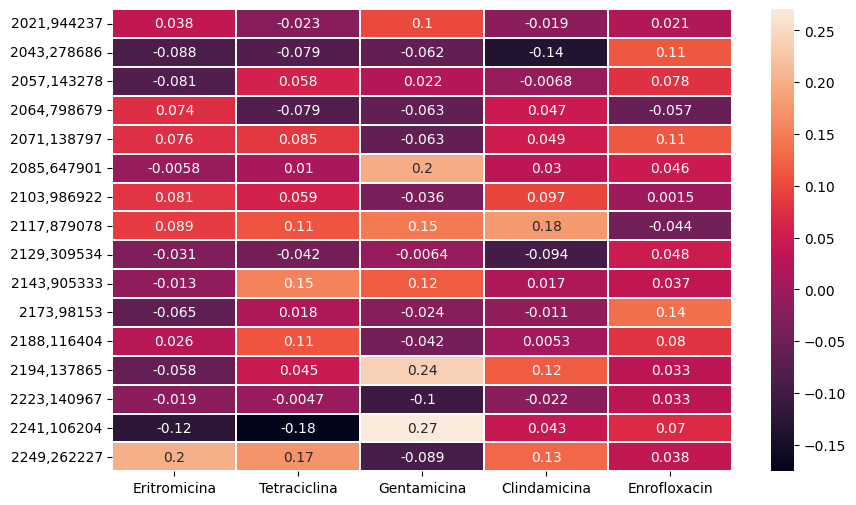

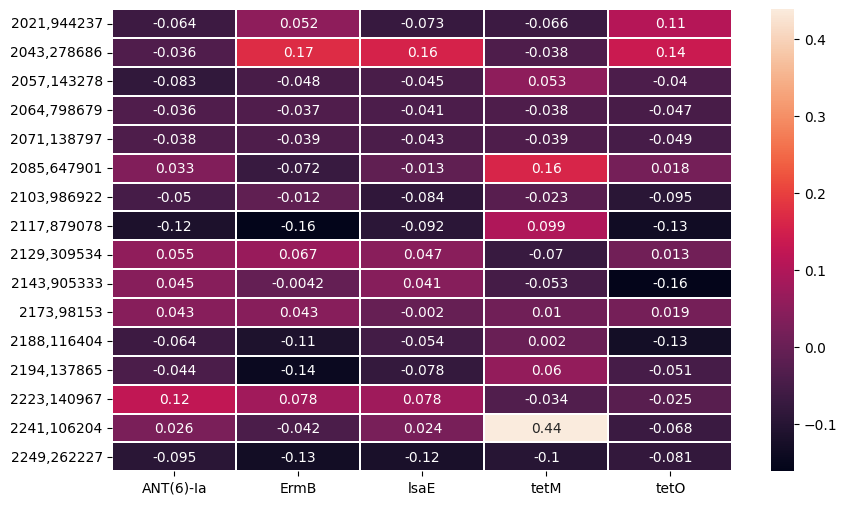

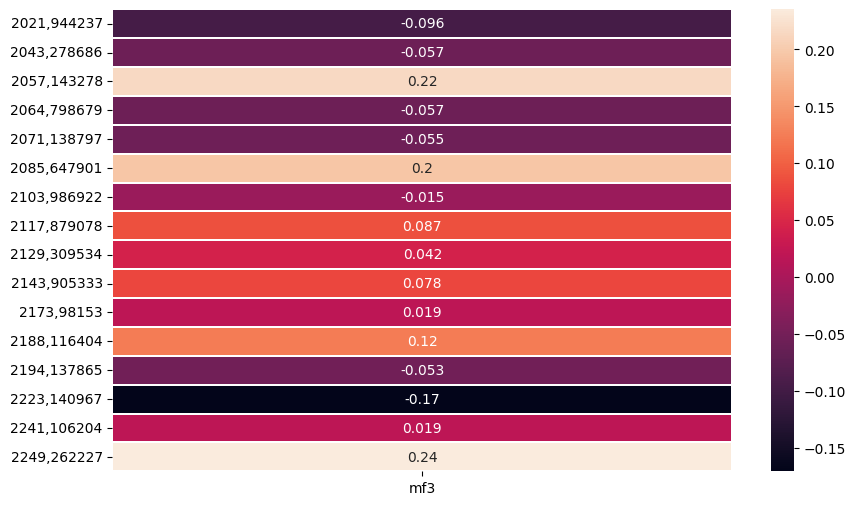

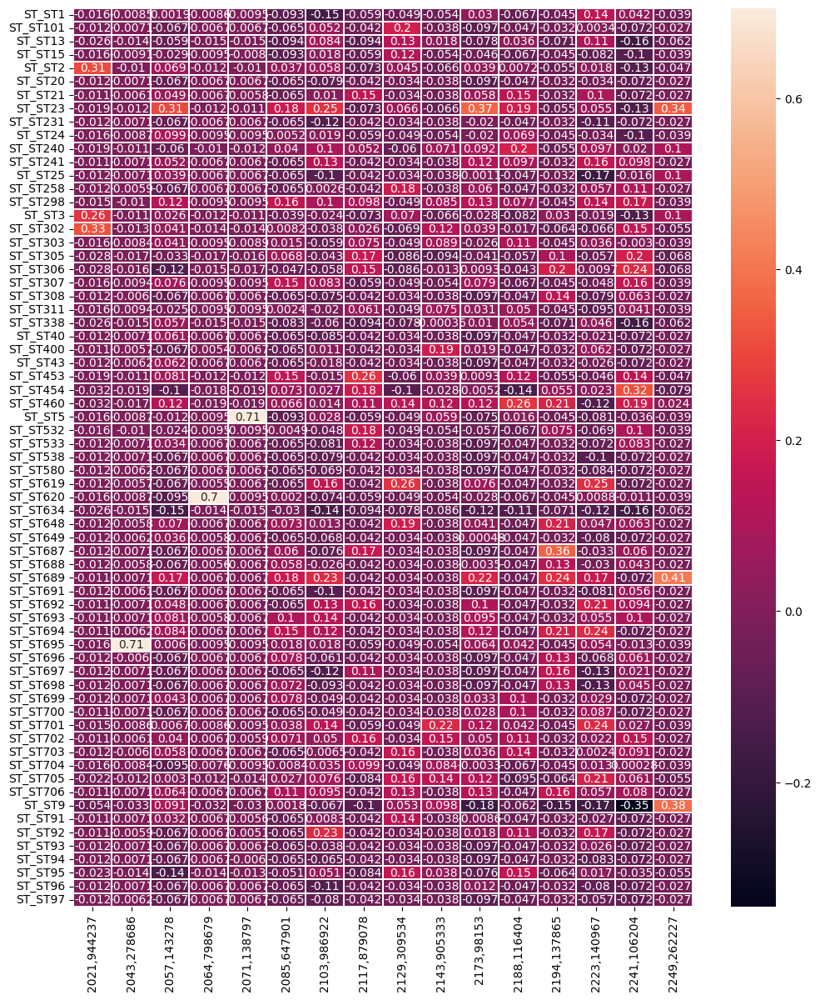

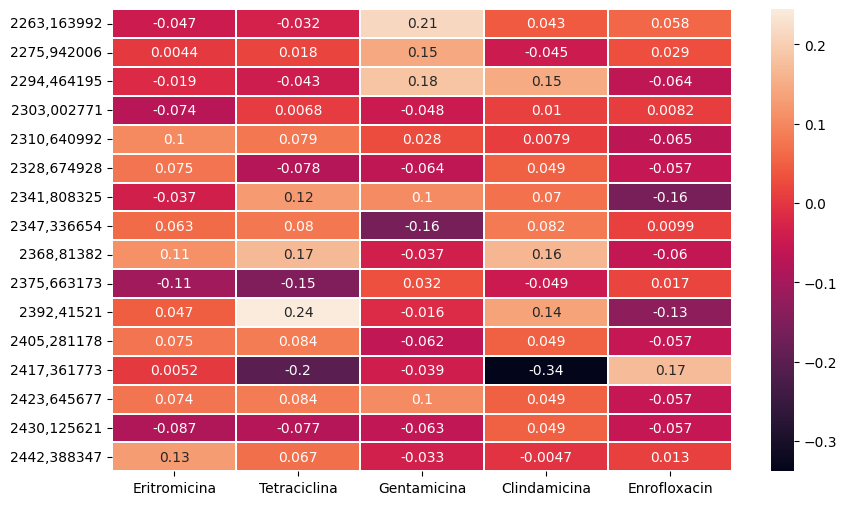

...

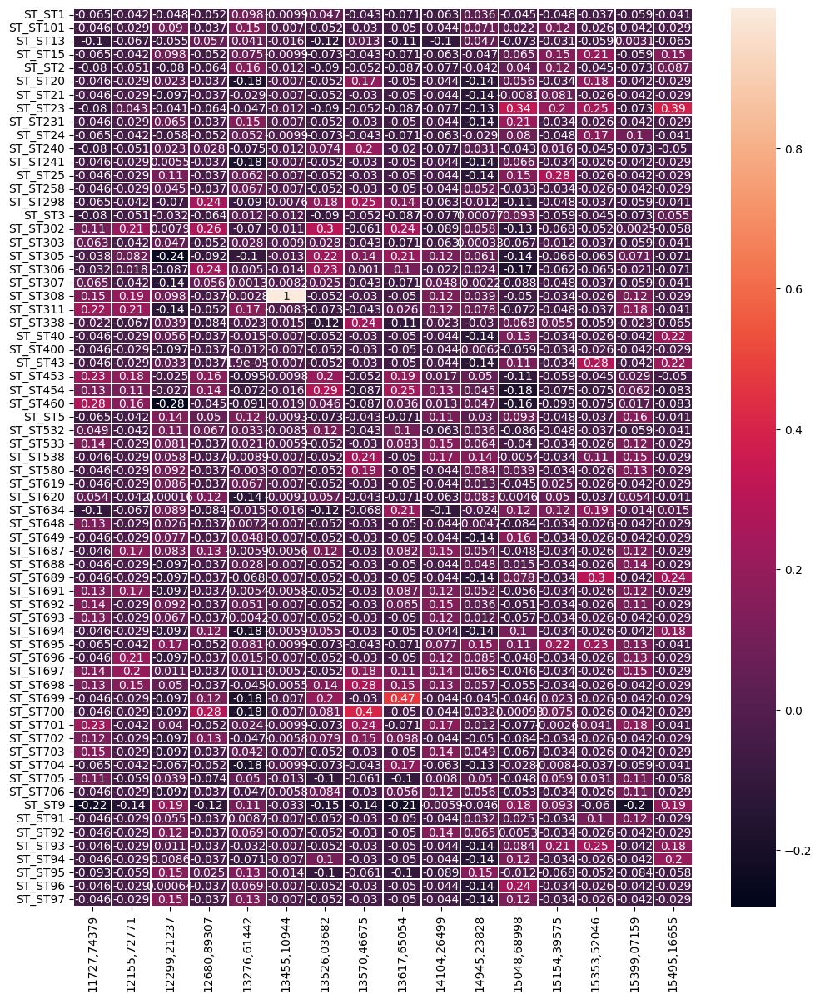

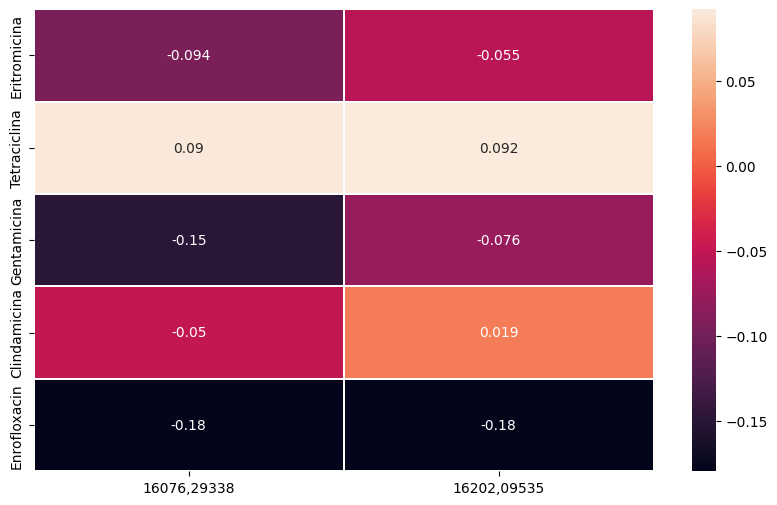

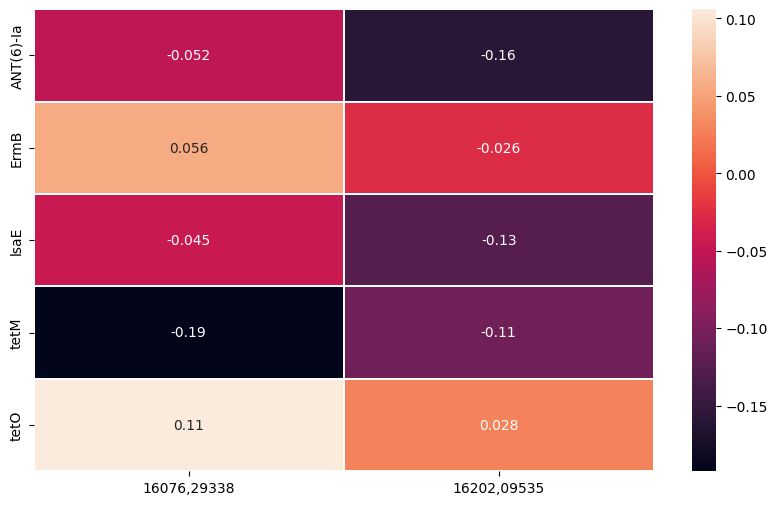

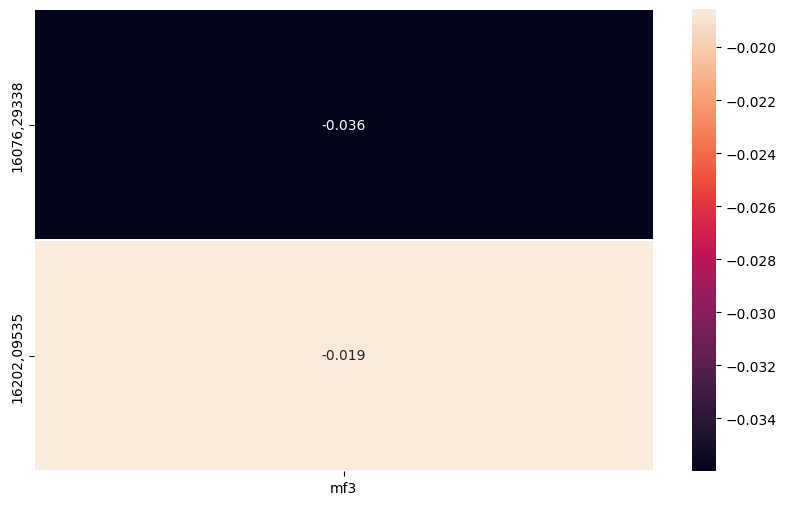

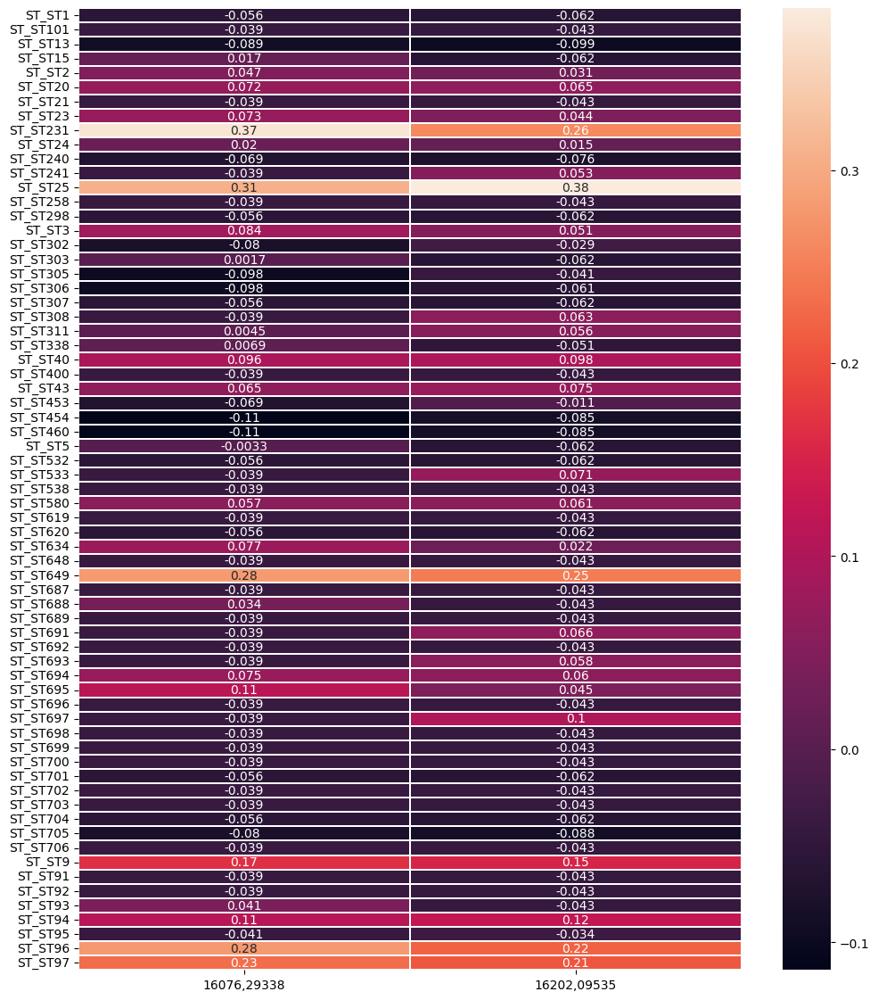

In [55]:
num_picchi = 16
#display(maldi)
#print(int(n/num_picchi)*num_picchi)
columns_i = [*range(0,int(n/num_picchi)*num_picchi+1,num_picchi)] 
columns_f = [*range(num_picchi,n,num_picchi),n]
dict_column = {columns_i[i]: columns_f[i] for i in range(len(columns_i))}

for column_i,column_f in dict_column.items():
    maldi_reduced = maldi.iloc[:, column_i:column_f]
    #display(maldi_reduced)
    for str_target, target in targets.items():
        if str_target == 'st':
            target = pd.DataFrame.from_dict(pd.get_dummies(target))
            #print(targ_feat.corr()[feat_agg.columns])
            plt.figure(figsize=(12, 14))
        else:
            plt.figure(figsize=(10, 6))
        targ_feat = pd.concat([target, maldi_reduced], axis=1)
        #print()
        if target.shape[1] > maldi_reduced.shape[1]:
            corr_target = targ_feat.corr().filter(items = maldi_reduced.columns, axis=1).filter(items = target.columns, axis=0)
            sns.heatmap(corr_target, annot=True, linewidths=0.2)
        else:
            corr_target = targ_feat.corr().filter(items = maldi_reduced.columns, axis=0).filter(items = target.columns, axis=1)
            sns.heatmap(corr_target, annot=True, linewidths=0.2)
        
        
        #plt.savefig('Risultati/Correlation/Maldi/'+str_target+'_'+str(n)+'_'+str(column_i)+'_'+str(column_f)+'.png')

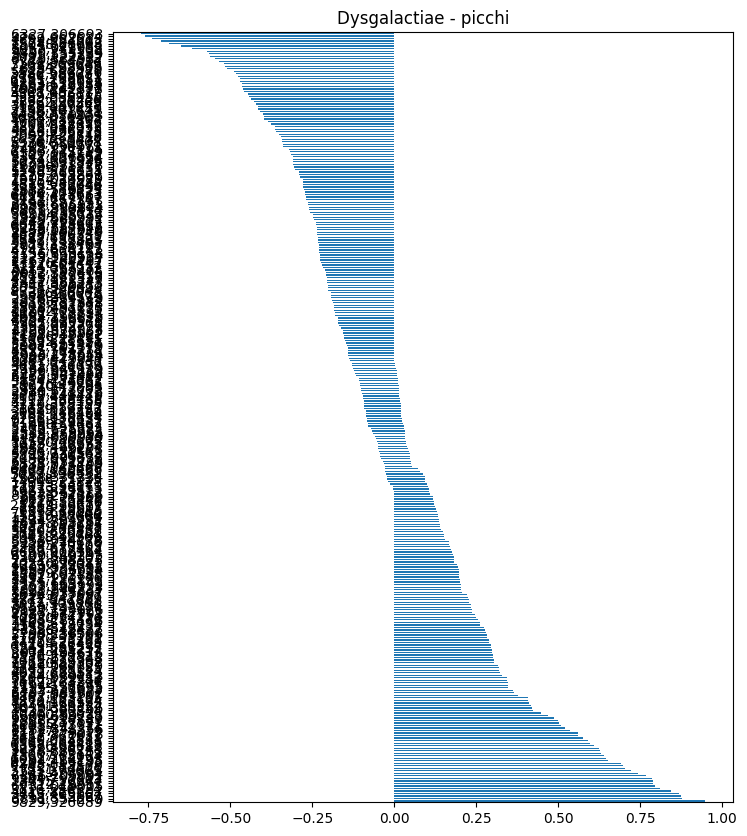

In [56]:
targets_cp = {'antibiotici' : antibiotici,
            'geni_antibiotici' : geni_antibiotici,
            'virulenza' : virulenza,
            'subspecies' : subspecies}
for str_target, target in targets_cp.items():
    columns = target.columns
    for column in columns:
        if str_target == 'subspecies':
            target = pd.DataFrame.from_dict(pd.get_dummies(target))
            target = target.rename(columns = {'Putative Subspecies_Streptococcus canis': "Canis",
                'Putative Subspecies_Streptococcus dysgalactiae subsp. equisimilis' : "Equisimilis",
                'Putative Subspecies_Streptococcus dysgalactiae subsp. dysgalactiae' : "Dysgalactiae"})
            #print(target)
            for col_subs in ['Canis', 'Equisimilis', 'Dysgalactiae']:
                targ_feat = pd.concat([target[col_subs], maldi], axis=1)
                #display(targ_feat)
                targ_feat.corr(method="spearman")[col_subs][1:].sort_values(ascending=False).plot(figsize=(8, 10), kind="barh", title=col_subs+' - picchi')    
                #plt.savefig('../Risultati/Correlation/Best/'+str_target+'/'+col_subs+'_picchiMaldi'+str(n)+'.png')
        else:
            targ_feat = pd.concat([target[column], maldi], axis=1)
            #display(targ_feat)
            targ_feat.corr(method="spearman")[column][1:].sort_values(ascending=False).plot(figsize=(8, 10), kind="barh", title=column+' - picchi')    
            #plt.savefig('../Risultati/Correlation/Best/'+str_target+'/'+column+'_picchiMaldi'+str(n)+'.png')

,"2021,944237","2043,278686","2057,143278","2064,798679","2071,138797","2085,647901","2103,986922","2117,879078","2129,309534","2143,905333","2173,98153","2188,116404","2194,137865","2223,140967","2241,106204","2249,262227"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000000,0.000066,0.000080,0.0,0.000000,0.000000,0.000086,0.000000,0.000052,0.000047,0.000068,0.000050,0.0,0.000665,0.000000,0.000000
V142,0.000000,0.000052,0.000000,0.0,0.000050,0.000045,0.000078,0.000000,0.000047,0.000000,0.000091,0.000000,0.0,0.000648,0.000000,0.000000
V151,0.000000,0.000058,0.000000,0.0,0.000060,0.000048,0.000100,0.000000,0.000000,0.000047,0.000054,0.000054,0.0,0.000545,0.000331,0.000000
V160,0.000000,0.000059,0.000000,0.0,0.000066,0.000000,0.000089,0.000000,0.000051,0.000000,0.000067,0.000000,0.0,0.000509,0.000000,0.000000
V161,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000077,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000517,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000056,0.000000,0.000055,0.0,0.000000,0.000060,0.000105,0.000000,0.000000,0.000000,0.000117,0.000000,0.0,0.000456,0.000253,0.000000
V82,0.000000,0.000050,0.000043,0.0,0.000000,0.000000,0.000066,0.000000,0.000000,0.000000,0.000053,0.000050,0.0,0.000459,0.000000,0.000144
V90,0.000000,0.000052,0.000000,0.0,0.000051,0.000000,0.000089,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000505,0.000000,0.000000


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"2263,163992","2275,942006","2294,464195","2303,002771","2310,640992","2328,674928","2341,808325","2347,336654","2368,81382","2375,663173","2392,41521","2405,281178","2417,361773","2423,645677","2430,125621","2442,388347"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000207,0.000000,0.000097,0.000000,0.000096,0.000077,0.000064,0.000000,0.000068,0.000000,0.000051,0.000000,0.000000,0.0,0.055390,0.000000
V142,0.000202,0.000167,0.000000,0.000000,0.000089,0.000000,0.000053,0.000000,0.000046,0.000000,0.000052,0.000000,0.000000,0.0,0.000000,0.000076
V151,0.000204,0.000138,0.000000,0.000000,0.000096,0.000000,0.000000,0.000053,0.000057,0.000000,0.000049,0.000000,0.000000,0.0,0.000000,0.000061
V160,0.000193,0.000209,0.000000,0.000000,0.000096,0.000000,0.000000,0.000054,0.000000,0.000000,0.000000,0.000047,0.000000,0.0,0.000051,0.000096
V161,0.000000,0.000211,0.000139,0.000000,0.000118,0.000000,0.000000,0.000046,0.000065,0.000000,0.000050,0.000000,0.000052,0.0,0.000000,0.000061
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000126,0.000000,0.000000,0.000135,0.000000,0.000049,0.000044,0.000000,0.000000,0.000187,0.000000,0.000051,0.000049,0.0,0.000043,0.000036
V82,0.000000,0.000178,0.000084,0.000000,0.000085,0.000000,0.000000,0.000045,0.000053,0.000000,0.000047,0.000000,0.000043,0.0,0.000000,0.000059
V90,0.000163,0.000131,0.000000,0.000000,0.000090,0.000000,0.000000,0.000053,0.000062,0.000000,0.000000,0.000054,0.000000,0.0,0.000000,0.000053


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"2458,082928","2463,871295","2478,385153","2490,961213","2499,934395","2507,013029","2514,979765","2526,491725","2535,074449","2546,810611","2568,858094","2587,941129","2597,603865","2605,933778","2614,99607","2633,510727"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000072,0.000000,0.00000,0.000000,0.0,0.000069,0.000000,0.000067,0.0,0.000000,0.000071,0.000000,0.000000,0.000126,0.000000,0.000251
V142,0.000000,0.000073,0.00000,0.000046,0.0,0.000073,0.000000,0.000054,0.0,0.000047,0.000000,0.000000,0.000000,0.000000,0.000057,0.000177
V151,0.000075,0.000000,0.00005,0.000000,0.0,0.000049,0.000000,0.000058,0.0,0.000000,0.000000,0.000000,0.000058,0.000000,0.000000,0.000184
V160,0.000088,0.000000,0.00000,0.000000,0.0,0.000068,0.000000,0.000062,0.0,0.000000,0.000000,0.000000,0.000059,0.000000,0.000000,0.000199
V161,0.000000,0.000105,0.00000,0.000000,0.0,0.000063,0.000000,0.000061,0.0,0.000000,0.000056,0.000000,0.000075,0.000000,0.000055,0.000217
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000062,0.000000,0.00005,0.000000,0.0,0.000000,0.000036,0.000035,0.0,0.000049,0.000000,0.000048,0.000000,0.000000,0.000037,0.000000
V82,0.000000,0.000059,0.00000,0.000046,0.0,0.000072,0.000000,0.000049,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000048,0.000158
V90,0.000086,0.000000,0.00005,0.000000,0.0,0.000000,0.000052,0.000058,0.0,0.000000,0.000000,0.000000,0.000000,0.000052,0.000054,0.000167


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"2644,803267","2658,331334","2679,74669","2695,110831","2726,59456","2740,248476","2756,849158","2767,264767","2774,677348","2791,836117","2798,238508","2811,189918","2832,466207","2867,706034","2885,237641","2901,101379"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000000,0.000000,0.000061,0.000000,0.000183,0.000000,0.000102,0.000000,0.000000,0.000063,0.000000,0.000065,0.000000,0.000000,0.000051,0.0
V142,0.000000,0.000071,0.000400,0.000000,0.000177,0.000000,0.000093,0.000000,0.000000,0.000000,0.000078,0.000000,0.000000,0.000047,0.000000,0.0
V151,0.000000,0.000000,0.000277,0.000000,0.000195,0.000000,0.000095,0.000000,0.000000,0.000000,0.000051,0.000000,0.000000,0.054910,0.000000,0.0
V160,0.000000,0.000000,0.000266,0.000000,0.000228,0.000000,0.000000,0.000093,0.000000,0.000000,0.000069,0.000000,0.000000,0.000050,0.000000,0.0
V161,0.000000,0.000000,0.000163,0.000000,0.000178,0.000000,0.000000,0.000119,0.000000,0.000062,0.000000,0.000000,0.000000,0.000058,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000148,0.000000,0.000000,0.000072,0.000167,0.000000,0.000093,0.000000,0.000106,0.000000,0.000047,0.000000,0.000000,0.000000,0.000066,0.0
V82,0.000000,0.000057,0.000270,0.000000,0.000170,0.000000,0.000097,0.000000,0.000000,0.000000,0.000051,0.000000,0.000000,0.000051,0.000000,0.0
V90,0.000000,0.000000,0.000182,0.000000,0.000183,0.000089,0.097310,0.000000,0.000000,0.000000,0.000057,0.000000,0.000000,0.000000,0.000000,0.0


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"2913,757878","2930,611773","2941,320452","2957,242323","2978,334119","3009,086529","3024,123226","3048,742669","3055,583516","3061,280788","3072,930078","3087,042335","3101,064562","3109,369649","3116,596924","3131,858727"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000054,0.000000,0.000000,0.000136,0.000865,0.000000,0.000000,0.000102,0.000000,0.000000,0.000000,0.0,0.000000,0.000080,0.0,0.0
V142,0.000044,0.000000,0.000050,0.000161,0.000698,0.000000,0.000000,0.000000,0.077920,0.000000,0.000065,0.0,0.000000,0.000148,0.0,0.0
V151,0.000055,0.000000,0.000000,0.000106,0.000613,0.000162,0.000146,0.000000,0.000000,0.000000,0.000057,0.0,0.000000,0.000170,0.0,0.0
V160,0.000000,0.000000,0.000000,0.000386,0.000489,0.000176,0.000155,0.000070,0.000000,0.000000,0.000049,0.0,0.000000,0.000181,0.0,0.0
V161,0.000000,0.000000,0.000049,0.000176,0.000610,0.000142,0.000147,0.000000,0.000093,0.000000,0.000066,0.0,0.000000,0.000163,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000000,0.000000,0.000000,0.000000,0.000586,0.000000,0.000082,0.000050,0.000000,0.000000,0.000041,0.0,0.000000,0.000000,0.0,0.0
V82,0.000000,0.000000,0.000000,0.000166,0.000571,0.000147,0.000127,0.000000,0.000074,0.000000,0.000051,0.0,0.000000,0.000116,0.0,0.0
V90,0.000058,0.000000,0.000000,0.000136,0.000610,0.000173,0.000146,0.000000,0.000000,0.000000,0.000057,0.0,0.000000,0.000148,0.0,0.0


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"3158,961645","3181,278665","3206,838377","3224,017932","3242,585235","3262,6002","3286,42422","3298,673403","3318,047933","3354,28405","3364,797303","3374,607979","3397,909861","3406,307673","3418,42909","3443,405164"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000497,0.0,0.000000,0.000000,0.000060,0.000058,0.000045,0.000000,0.000066,0.000000,0.000272,0.000000,0.000578,0.000000,0.000000,0.000000
V142,0.000414,0.0,0.000053,0.000047,0.000000,0.000000,0.000050,0.000000,0.000103,0.000684,0.000000,0.000505,0.000617,0.000000,0.000494,0.000000
V151,0.000464,0.0,0.000053,0.000000,0.000000,0.000047,0.000000,0.000000,0.000000,0.000000,0.001031,0.000000,0.000624,0.000000,0.000409,0.000197
V160,0.000358,0.0,0.000051,0.000052,0.000000,0.000000,0.000000,0.000000,0.000091,0.000000,0.000692,0.000000,0.000564,0.000000,0.000611,0.000000
V161,0.000502,0.0,0.000052,0.000000,0.000000,0.000000,0.000051,0.000000,0.000086,0.000621,0.000000,0.000431,0.000507,0.000000,0.000638,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000365,0.0,0.000067,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001095,0.000000,0.000537,0.000000,0.000000,0.000000
V82,0.000338,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000046,0.000000,0.000596,0.000000,0.000548,0.000537,0.000000,0.000668,0.000000
V90,0.000473,0.0,0.000056,0.000000,0.000000,0.000000,0.000000,0.000000,0.000067,0.000000,0.000525,0.000000,0.000513,0.000000,0.000377,0.000000


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"3469,517094","3496,883221","3522,147448","3542,182893","3551,127176","3559,038986","3565,064583","3588,460745","3629,19292","3642,953603","3650,035831","3666,795775","3691,127352","3698,016465","3718,855667","3740,071562"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000158,0.000083,0.0,0.000072,0.000000,0.000000,0.000000,0.000048,0.000000,0.000136,0.0,0.000065,0.000213,0.000000,0.00000,0.000078
V142,0.000274,0.000000,0.0,0.000000,0.000000,0.000071,0.000000,0.000086,0.000000,0.000107,0.0,0.000203,0.000000,0.000227,0.00000,0.000066
V151,0.000322,0.000149,0.0,0.000060,0.000000,0.000058,0.000000,0.000132,0.000000,0.000149,0.0,0.000132,0.000208,0.000000,0.00000,0.000091
V160,0.000337,0.000160,0.0,0.000000,0.000000,0.000052,0.000000,0.000089,0.000000,0.000160,0.0,0.000285,0.000274,0.000000,0.00000,0.000078
V161,0.000236,0.000137,0.0,0.000000,0.000000,0.000057,0.000000,0.000105,0.000000,0.000124,0.0,0.000089,0.000000,0.000195,0.00000,0.000065
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000000,0.000000,0.0,0.000000,0.000149,0.000000,0.000153,0.000040,0.000181,0.000162,0.0,0.000000,0.000000,0.000000,0.00021,0.000072
V82,0.000308,0.000000,0.0,0.000059,0.000000,0.000056,0.000000,0.000087,0.000000,0.000123,0.0,0.000147,0.000000,0.000228,0.00000,0.000068
V90,0.000270,0.000142,0.0,0.000078,0.000000,0.000000,0.000000,0.000000,0.000000,0.000147,0.0,0.000136,0.000286,0.000000,0.00000,0.000075


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"3762,662684","3772,942539","3789,670201","3802,063287","3827,164685","3854,434602","3875,780248","3886,289081","3901,593197","3952,786854","4013,479041","4024,076978","4039,689523","4091,355124","4113,564168","4142,664282"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000083,0.00000,0.00000,0.000000,0.000000,0.000055,0.000000,0.000090,0.000000,0.000806,0.000000,0.000000,0.000087,0.000504,0.0,0.0
V142,0.000070,0.00000,0.00005,0.000000,0.000000,0.000000,0.000000,0.000062,0.000000,0.000641,0.000000,0.000087,0.000000,0.000499,0.0,0.0
V151,0.000000,0.00005,0.00000,0.000000,0.000048,0.000000,0.000000,0.000050,0.000000,0.000641,0.000000,0.000086,0.000000,0.000559,0.0,0.0
V160,0.000063,0.00000,0.00000,0.000000,0.000000,0.000049,0.000000,0.000000,0.000000,0.000648,0.000000,0.000000,0.000000,0.000659,0.0,0.0
V161,0.000083,0.00000,0.00000,0.000000,0.000061,0.000050,0.000000,0.000064,0.000000,0.000679,0.000000,0.000088,0.000000,0.000492,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000000,0.00000,0.00000,0.000035,0.000000,0.000000,0.000039,0.000000,0.000000,0.000633,0.000082,0.000000,0.000061,0.000572,0.0,0.0
V82,0.000056,0.00000,0.00000,0.000000,0.000000,0.000044,0.000000,0.000093,0.000000,0.000606,0.000000,0.000074,0.000000,0.000529,0.0,0.0
V90,0.000068,0.00000,0.00000,0.000000,0.000054,0.000055,0.000000,0.000114,0.000000,0.000605,0.000000,0.000075,0.000064,0.000526,0.0,0.0


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"4156,733951","4176,580509","4200,320563","4216,375125","4234,704731","4252,573437","4302,849101","4345,70109","4379,474113","4451,322399","4474,966395","4490,255734","4515,184774","4536,279832","4547,906115","4595,891317"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000000,0.000066,0.000000,0.000056,0.000045,0.000046,0.000000,0.000048,0.000048,0.001233,0.000000,0.000386,0.000384,0.000249,0.000000,0.000127
V142,0.000000,0.000051,0.000000,0.000000,0.000000,0.000000,0.000000,0.000048,0.000062,0.001305,0.000000,0.000366,0.000491,0.000342,0.000000,0.000162
V151,0.000074,0.000000,0.000047,0.000048,0.000000,0.000000,0.000000,0.000000,0.000000,0.001035,0.000320,0.000297,0.000403,0.000376,0.000000,0.000127
V160,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000050,0.000995,0.000342,0.000269,0.000441,0.000400,0.000000,0.000132
V161,0.000062,0.000056,0.000048,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001046,0.000000,0.000260,0.000394,0.000000,0.000343,0.000128
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000000,0.000049,0.000000,0.000000,0.000000,0.000000,0.000000,0.000039,0.000000,0.001221,0.000000,0.000496,0.000000,0.000262,0.000000,0.000159
V82,0.000062,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000047,0.001083,0.000000,0.000298,0.000395,0.000349,0.000000,0.000130
V90,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.001042,0.000333,0.000284,0.000411,0.000400,0.000000,0.000180


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"4623,196559","4700,985807","4744,087329","4810,080788","4863,622184","4877,931808","4899,987515","4914,816607","4931,990544","4983,4467","5017,741108","5039,291849","5052,449441","5114,565557","5132,757147","5165,731993"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000098,0.000000,0.000631,0.000000,0.000055,0.000000,0.000056,0.000000,0.000050,0.000110,0.000184,0.000000,0.000310,0.0,0.000114,0.000000
V142,0.000118,0.000051,0.000420,0.000000,0.000047,0.000000,0.000057,0.000000,0.000044,0.000095,0.000188,0.000000,0.000265,0.0,0.000050,0.000047
V151,0.000088,0.000053,0.000582,0.000092,0.000000,0.000000,0.000069,0.000000,0.000054,0.000136,0.000000,0.000000,0.000326,0.0,0.000080,0.000000
V160,0.000109,0.000047,0.000000,0.000052,0.000000,0.000000,0.000072,0.000000,0.000050,0.000129,0.000146,0.000000,0.000333,0.0,0.000062,0.000000
V161,0.000096,0.000060,0.000718,0.000109,0.000000,0.000000,0.000058,0.000000,0.000053,0.000120,0.000246,0.000000,0.000362,0.0,0.000094,0.000065
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000000,0.000000,0.000787,0.000211,0.000000,0.000035,0.000000,0.000052,0.000063,0.000070,0.000000,0.000000,0.000315,0.0,0.000048,0.000000
V82,0.000088,0.000046,0.000368,0.000056,0.000000,0.000000,0.000073,0.000000,0.000000,0.000096,0.000129,0.000000,0.000308,0.0,0.000053,0.000063
V90,0.000000,0.000069,0.000646,0.000123,0.000000,0.000000,0.000064,0.000000,0.000000,0.000130,0.000159,0.000000,0.000339,0.0,0.000083,0.000069


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"5200,839932","5245,799185","5283,615576","5296,883734","5319,28006","5362,842812","5397,767318","5421,647767","5465,677464","5490,200857","5506,228855","5522,688276","5539,233403","5552,767932","5562,26269","5586,260579"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000000,0.000109,0.000000,0.0,0.000000,0.000047,0.000045,0.000000,0.000247,0.0,0.0,0.000180,0.000000,0.000000,0.000097,0.000072
V142,0.000170,0.000145,0.000048,0.0,0.000096,0.000623,0.000000,0.000089,0.000193,0.0,0.0,0.000182,0.000000,0.000000,0.000081,0.000064
V151,0.000280,0.000205,0.000000,0.0,0.000066,0.000401,0.000000,0.000000,0.000275,0.0,0.0,0.000184,0.000000,0.000000,0.000087,0.000056
V160,0.000319,0.000247,0.000000,0.0,0.000078,0.000403,0.000000,0.000000,0.000292,0.0,0.0,0.000000,0.000120,0.000000,0.000052,0.000000
V161,0.000212,0.000171,0.000000,0.0,0.000000,0.000255,0.000074,0.000062,0.000208,0.0,0.0,0.000204,0.000000,0.000000,0.000092,0.000068
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000103,0.000139,0.000000,0.0,0.000000,0.000000,0.000000,0.000044,0.000443,0.0,0.0,0.000000,0.000000,0.000091,0.000000,0.000000
V82,0.000229,0.000184,0.000000,0.0,0.000078,0.000488,0.000000,0.000073,0.000224,0.0,0.0,0.000188,0.000000,0.000000,0.000072,0.000000
V90,0.000297,0.000244,0.000000,0.0,0.000063,0.000273,0.000000,0.000104,0.000290,0.0,0.0,0.000180,0.000142,0.000000,0.000092,0.000000


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"5601,497971","5623,635629","5639,896531","5655,590999","5668,71725","5742,125383","5780,539599","5857,658321","5870,173124","5914,177605","5926,836608","5956,270678","5968,682877","5995,730563","6013,377415","6059,718917"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000000,0.000052,0.000049,0.000000,0.000000,0.000045,0.0,0.0,0.000000,0.000237,0.000000,0.001131,0.000000,0.000362,0.000208,0.000000
V142,0.000119,0.000000,0.000000,0.000051,0.000046,0.000068,0.0,0.0,0.000000,0.000000,0.000310,0.000000,0.001018,0.000000,0.000275,0.000118
V151,0.000054,0.000000,0.000000,0.000000,0.000000,0.000079,0.0,0.0,0.000051,0.000188,0.000000,0.000829,0.000000,0.000216,0.000000,0.000083
V160,0.000000,0.000000,0.000000,0.000050,0.000000,0.000081,0.0,0.0,0.000117,0.000566,0.000000,0.000705,0.000000,0.000172,0.000000,0.000079
V161,0.000060,0.000000,0.000000,0.000000,0.000000,0.000117,0.0,0.0,0.000000,0.000000,0.000287,0.000000,0.000850,0.000000,0.000000,0.000087
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000082,0.000041,0.000000,0.000000,0.000000,0.000051,0.0,0.0,0.000080,0.000235,0.000000,0.000988,0.000000,0.000000,0.000000,0.000000
V82,0.000061,0.000000,0.000000,0.000046,0.000000,0.000064,0.0,0.0,0.000058,0.000349,0.000000,0.000000,0.000926,0.000000,0.000000,0.000000
V90,0.000000,0.000000,0.000000,0.000000,0.000000,0.000087,0.0,0.0,0.000000,0.000244,0.000000,0.000891,0.000000,0.000229,0.000000,0.000000


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"6081,114293","6100,449295","6112,579053","6127,124926","6150,145119","6171,751765","6205,064571","6227,030576","6245,557645","6261,118018","6283,92929","6312,28957","6327,306693","6366,205097","6387,479047","6415,650959"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000000,0.000116,0.000000,0.000091,0.000082,0.000000,0.000000,0.000095,0.000000,0.045120,0.000000,0.0000,0.000554,0.000157,0.000000,0.000063
V142,0.000000,0.000000,0.000108,0.000000,0.000091,0.000060,0.000000,0.000238,0.000000,0.000069,0.000092,0.0000,0.000590,0.000000,0.000098,0.000000
V151,0.000000,0.000071,0.000000,0.000050,0.000071,0.000055,0.000000,0.000237,0.000000,0.000066,0.000077,0.0000,0.000539,0.000000,0.000000,0.000000
V160,0.000000,0.000070,0.000000,0.000000,0.000069,0.000049,0.000000,0.000285,0.000000,0.000079,0.000100,0.0000,0.000576,0.000000,0.000000,0.000000
V161,0.000000,0.000000,0.000085,0.000000,0.000120,0.000000,0.000000,0.000245,0.000000,0.000055,0.000067,0.0000,0.000564,0.000000,0.000078,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000000,0.000078,0.000000,0.000044,0.000000,0.000053,0.000000,0.000036,0.000000,0.000000,0.000000,0.0007,0.000000,0.000158,0.000000,0.000077
V82,0.000000,0.000000,0.000097,0.000000,0.000070,0.000050,0.000000,0.000204,0.000000,0.000000,0.000072,0.0000,0.000549,0.000000,0.000000,0.000000
V90,0.000063,0.000089,0.000000,0.000000,0.000099,0.000000,0.000000,0.000239,0.000000,0.000080,0.000091,0.0000,0.000598,0.000000,0.000000,0.000000


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"6455,067424","6489,060486","6568,268419","6587,606933","6600,699745","6639,906314","6710,334937","6731,019005","6751,288851","6768,619178","6797,381802","6814,418663","6839,12615","6861,319414","6891,554249","6941,861547"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000000,0.000052,0.000000,0.000000,0.0,0.000158,0.000264,0.000222,0.000000,0.000000,0.000663,0.000000,0.000217,0.0,0.000000,0.000145
V142,0.000000,0.000000,0.000000,0.000000,0.0,0.000156,0.000986,0.000000,0.000670,0.000000,0.000771,0.000000,0.000546,0.0,0.000000,0.000288
V151,0.000000,0.000047,0.000000,0.000000,0.0,0.000186,0.000000,0.001330,0.000000,0.000568,0.000746,0.000000,0.000449,0.0,0.000226,0.000308
V160,0.000000,0.000000,0.000000,0.000000,0.0,0.000179,0.000870,0.000780,0.000000,0.000000,0.000707,0.000000,0.000657,0.0,0.000000,0.000316
V161,0.000000,0.000000,0.000000,0.000000,0.0,0.000191,0.000855,0.000000,0.000528,0.000000,0.000622,0.000000,0.000858,0.0,0.000000,0.000232
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000000,0.000000,0.000036,0.000000,0.0,0.000139,0.000000,0.001666,0.000000,0.000000,0.000790,0.000000,0.000335,0.0,0.000000,0.000000
V82,0.000000,0.000000,0.000000,0.000056,0.0,0.000120,0.000938,0.000000,0.000760,0.000000,0.000772,0.000000,0.001036,0.0,0.000000,0.000372
V90,0.000000,0.000000,0.000000,0.000000,0.0,0.000188,0.000555,0.000602,0.000000,0.000000,0.000658,0.000000,0.000419,0.0,0.000000,0.000273


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"6978,383674","7002,828847","7028,338252","7051,439392","7086,679678","7101,854571","7159,909273","7184,708622","7202,146723","7231,04021","7259,660266","7282,008428","7300,542143","7319,793861","7335,730413","7382,854053"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000070,0.000000,0.000045,0.000052,0.00000,0.000093,0.000000,0.000000,0.000000,0.0,0.000000,0.000065,0.000000,0.0,0.000046,0.000249
V142,0.000000,0.000085,0.000000,0.000062,0.00000,0.000000,0.000124,0.000000,0.000000,0.0,0.000000,0.060340,0.000000,0.0,0.000199,0.000000
V151,0.000000,0.000000,0.000081,0.090780,0.00000,0.000000,0.000050,0.000193,0.000061,0.0,0.000000,0.000062,0.000000,0.0,0.000110,0.000245
V160,0.000132,0.000000,0.000000,0.000072,0.00000,0.000000,0.000000,0.000116,0.000000,0.0,0.000000,0.000069,0.000000,0.0,0.000267,0.000316
V161,0.000000,0.000000,0.000000,0.000085,0.00000,0.000000,0.000000,0.000148,0.000074,0.0,0.000000,0.000066,0.000000,0.0,0.000070,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000000,0.000000,0.000000,0.000106,0.00000,0.000176,0.000000,0.000000,0.000000,0.0,0.000300,0.000000,0.000091,0.0,0.000000,0.000000
V82,0.000000,0.000000,0.000000,0.000073,0.00000,0.000000,0.000000,0.000128,0.000000,0.0,0.000000,0.000063,0.000000,0.0,0.000159,0.000000
V90,0.000000,0.000000,0.000000,0.000106,0.00000,0.000085,0.000000,0.000000,0.000000,0.0,0.000000,0.000077,0.000000,0.0,0.000126,0.000377


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"7396,541531","7442,183508","7474,126791","7525,524802","7582,123246","7597,936488","7675,5437","7701,038434","7905,893368","7967,158882","8004,05774","8045,073053","8074,407676","8101,722824","8182,843356","8244,689213"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000000,0.000000,0.000171,0.000301,0.0,0.00000,0.000000,0.000056,0.000819,0.000000,0.0,0.000112,0.000000,0.000000,0.000457,0.00000
V142,0.000291,0.000000,0.000150,0.000309,0.0,0.00000,0.000000,0.000053,0.000712,0.000000,0.0,0.000094,0.000069,0.000000,0.000505,0.00000
V151,0.000000,0.000000,0.000210,0.000115,0.0,0.00000,0.000000,0.000072,0.000677,0.000000,0.0,0.000083,0.000000,0.000080,0.000512,0.00000
V160,0.000000,0.000000,0.000189,0.000212,0.0,0.00000,0.000000,0.000065,0.000711,0.000000,0.0,0.084440,0.000069,0.000000,0.000635,0.00000
V161,0.000234,0.000000,0.000172,0.000349,0.0,0.00011,0.000053,0.000073,0.000713,0.000000,0.0,0.000103,0.000083,0.000087,0.000477,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000000,0.000280,0.000147,0.000090,0.0,0.00000,0.000000,0.000038,0.000776,0.000204,0.0,0.000084,0.000086,0.000000,0.000617,0.00015
V82,0.000319,0.000000,0.000156,0.000199,0.0,0.00000,0.000000,0.000049,0.000758,0.000000,0.0,0.000088,0.000068,0.000000,0.000592,0.00000
V90,0.000000,0.000000,0.000229,0.000238,0.0,0.00000,0.000000,0.000086,0.000675,0.000000,0.0,0.000096,0.000000,0.000000,0.000525,0.00000


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"8326,388948","8353,024278","8692,035007","8823,297366","8900,417914","9030,383766","9073,25717","9169,229432","9216,19705","9256,178637","9487,183195","9550,735174","9617,35446","9652,709405","9795,555239","9829,326089"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000000,0.000000,0.000045,0.000054,0.000000,0.000206,0.000135,0.000052,0.000000,0.000065,0.000587,0.000000,0.000000,0.000000,0.000047,0.000000
V142,0.000000,0.000000,0.000000,0.000000,0.000047,0.000219,0.000205,0.000000,0.000000,0.000064,0.000465,0.000000,0.000000,0.000000,0.000050,0.000000
V151,0.000059,0.000000,0.000000,0.000000,0.000000,0.000261,0.000263,0.000000,0.000052,0.000000,0.000585,0.000000,0.000085,0.000000,0.000055,0.000000
V160,0.000000,0.000060,0.000000,0.000000,0.000000,0.000311,0.000312,0.000000,0.000061,0.000086,0.000000,0.000000,0.000000,0.000000,0.000060,0.000000
V161,0.000000,0.000000,0.000000,0.000000,0.000000,0.000206,0.000224,0.000050,0.000000,0.000062,0.000711,0.000000,0.000089,0.000000,0.000049,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000000,0.000042,0.000000,0.000000,0.000052,0.000103,0.000195,0.000000,0.000000,0.000000,0.000843,0.000218,0.000240,0.000000,0.000000,0.000059
V82,0.000000,0.000050,0.000000,0.000000,0.000000,0.000263,0.000277,0.000068,0.000048,0.000050,0.000452,0.000000,0.000062,0.000000,0.000066,0.000000
V90,0.000000,0.000000,0.000000,0.000000,0.000000,0.000288,0.000310,0.000000,0.000057,0.000063,0.000671,0.000000,0.000092,0.000000,0.000000,0.000000


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"9862,918789","10077,27416","10103,17897","10172,64397","10204,5893","10246,99083","10279,75573","10329,44248","10400,82679","10491,36334","10930,54276","11010,07664","11070,93101","11175,10652","11246,47191","11482,18754"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000000,0.000000,0.000180,0.000064,0.000000,0.000050,0.000000,0.000000,0.000066,0.000065,0.000172,0.0,0.000000,0.0,0.0,0.000000
V142,0.000000,0.000000,0.000193,0.000000,0.000000,0.000000,0.000000,0.000049,0.000142,0.000116,0.000165,0.0,0.000000,0.0,0.0,0.000000
V151,0.000000,0.000000,0.000235,0.000063,0.000000,0.000000,0.000000,0.000000,0.000198,0.000152,0.000208,0.0,0.000000,0.0,0.0,0.000057
V160,0.000049,0.000000,0.000241,0.000000,0.000000,0.000000,0.000000,0.000053,0.000242,0.000187,0.000245,0.0,0.000000,0.0,0.0,0.000049
V161,0.000000,0.000000,0.000242,0.000000,0.000065,0.000048,0.000000,0.000000,0.000156,0.000116,0.000154,0.0,0.000000,0.0,0.0,0.000070
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000066,0.000000,0.000250,0.000062,0.000000,0.000000,0.000036,0.000000,0.000088,0.000109,0.000298,0.0,0.000053,0.0,0.0,0.000041
V82,0.000000,0.000000,0.000254,0.000000,0.000000,0.000049,0.000043,0.000063,0.000211,0.000162,0.000203,0.0,0.000000,0.0,0.0,0.000000
V90,0.000000,0.000000,0.000237,0.000000,0.000000,0.000000,0.000000,0.000054,0.000224,0.000185,0.000230,0.0,0.000000,0.0,0.0,0.000062


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"11727,74379","12155,72771","12299,21237","12680,89307","13276,61442","13455,10944","13526,03682","13570,46675","13617,65054","14104,26499","14945,23828","15048,68998","15154,39575","15353,52046","15399,07159","15495,16655"
ID Strain,,,,,,,,,,,,,,,,
V13,0.000000,0.0,0.000000,0.0,0.000076,0.000000,0.0,0.0,0.0,0.000000,0.000066,0.000142,0.0,0.0,0.000000,0.0
V142,0.000000,0.0,0.000047,0.0,0.000068,0.000000,0.0,0.0,0.0,0.000000,0.000085,0.000194,0.0,0.0,0.000000,0.0
V151,0.000000,0.0,0.000059,0.0,0.000084,0.000000,0.0,0.0,0.0,0.000000,0.000092,0.000070,0.0,0.0,0.000000,0.0
V160,0.000000,0.0,0.000053,0.0,0.000082,0.000000,0.0,0.0,0.0,0.000000,0.000098,0.000136,0.0,0.0,0.000000,0.0
V161,0.000000,0.0,0.000077,0.0,0.000093,0.000000,0.0,0.0,0.0,0.000000,0.000089,0.000203,0.0,0.0,0.000000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
V800,0.000041,0.0,0.000000,0.0,0.000060,0.000040,0.0,0.0,0.0,0.000036,0.000073,0.000060,0.0,0.0,0.000000,0.0
V82,0.000000,0.0,0.000046,0.0,0.000061,0.000000,0.0,0.0,0.0,0.000000,0.000090,0.000144,0.0,0.0,0.000000,0.0
V90,0.000000,0.0,0.000081,0.0,0.000089,0.000000,0.0,0.0,0.0,0.000000,0.000104,0.000137,0.0,0.0,0.000051,0.0


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


,"16076,29338","16202,09535"
ID Strain,,
V13,0.0,0.0
V142,0.0,0.0
V151,0.0,0.0
V160,0.0,0.0
V161,0.0,0.0
...,...,...
V800,0.0,0.0
V82,0.0,0.0
V90,0.0,0.0


,Canis,Dysgalactiae,Equisimilis
ID Strain,,,
V13,1,0,0
V142,1,0,0
V151,1,0,0
V160,1,0,0
V161,1,0,0
...,...,...,...
V800,0,1,0
V82,1,0,0
V90,1,0,0


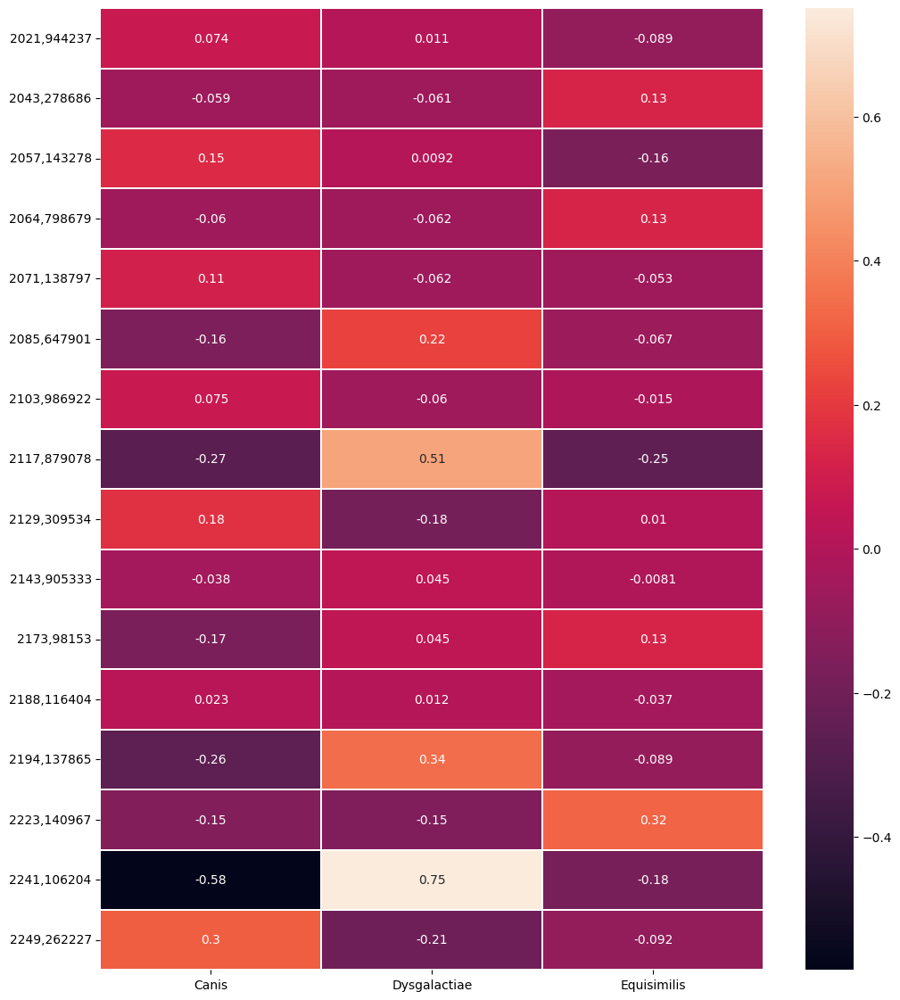

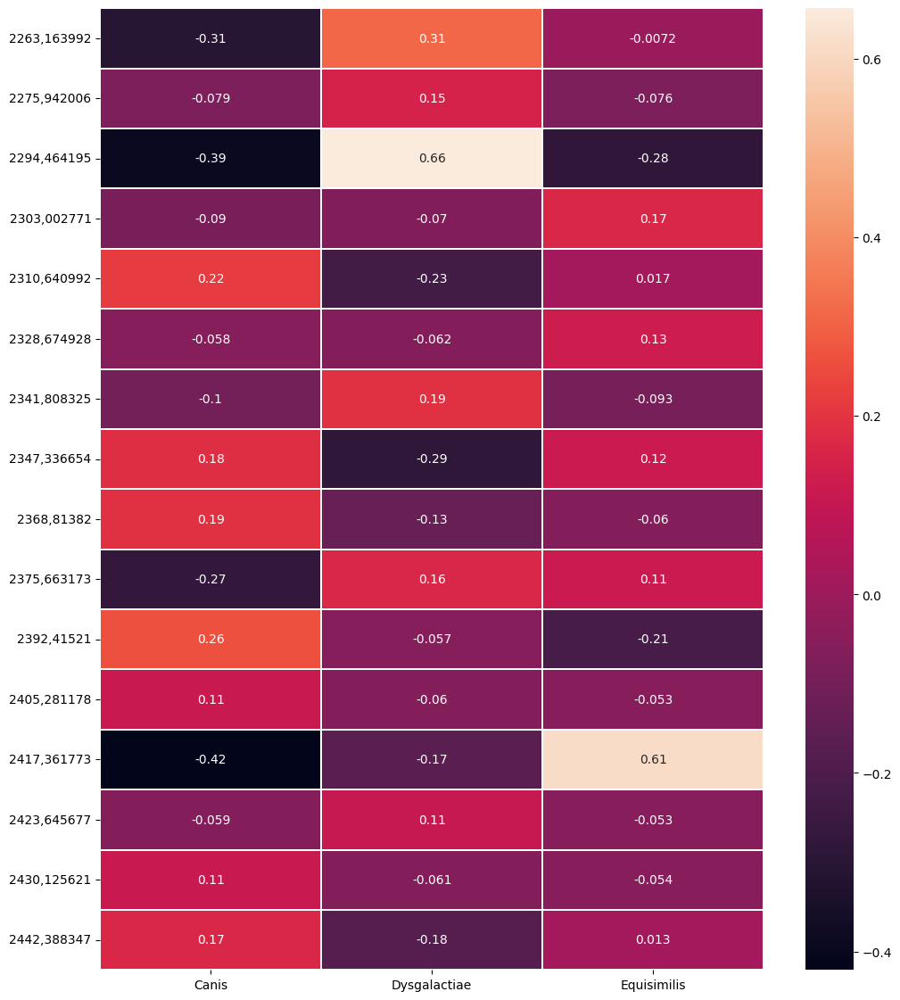

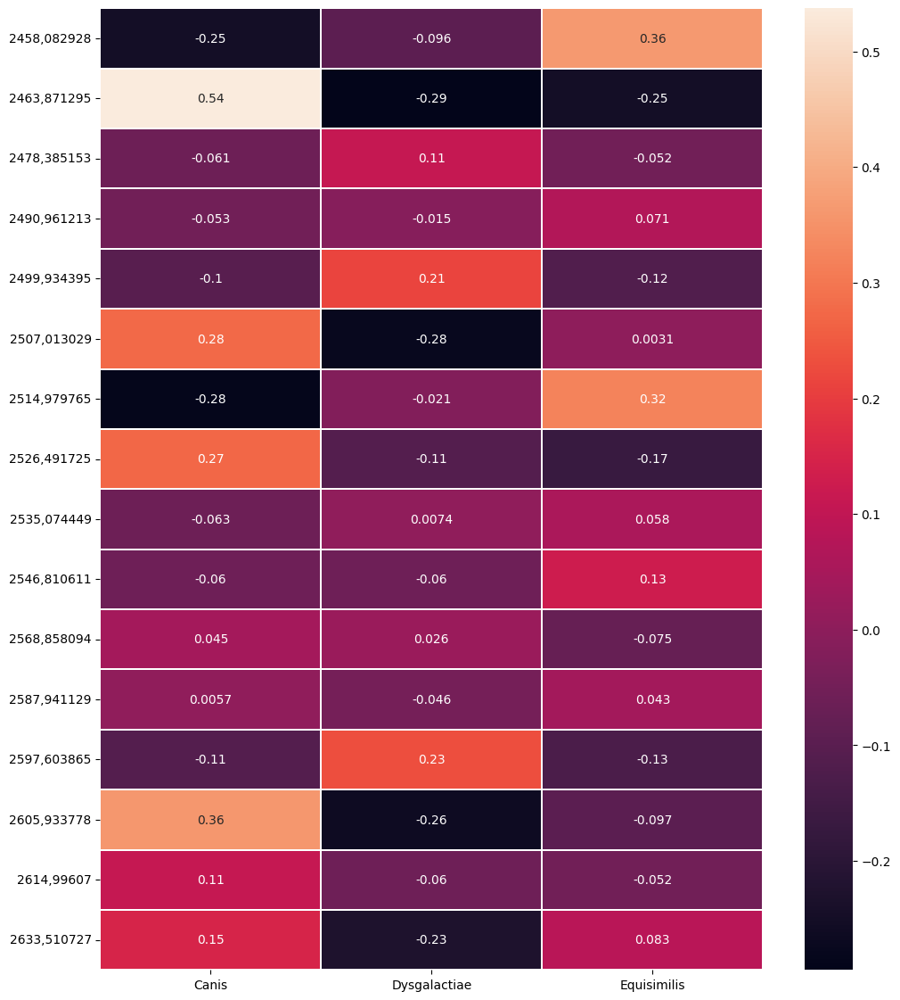

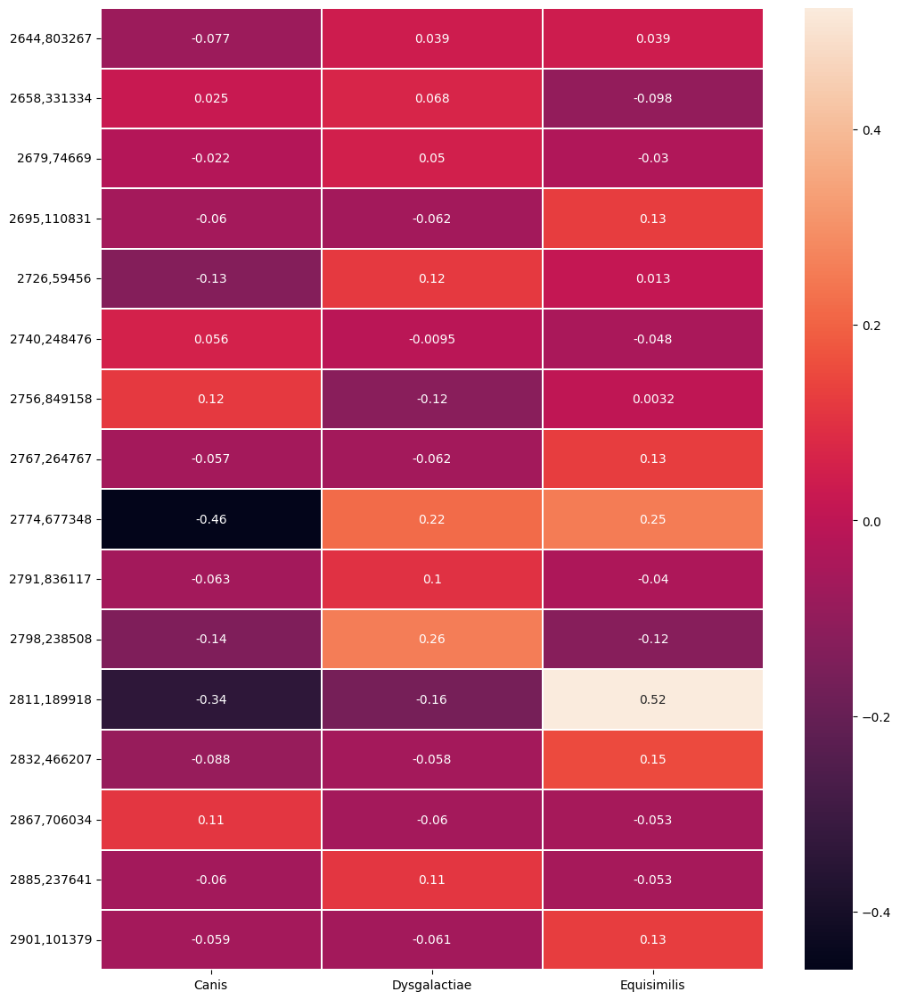

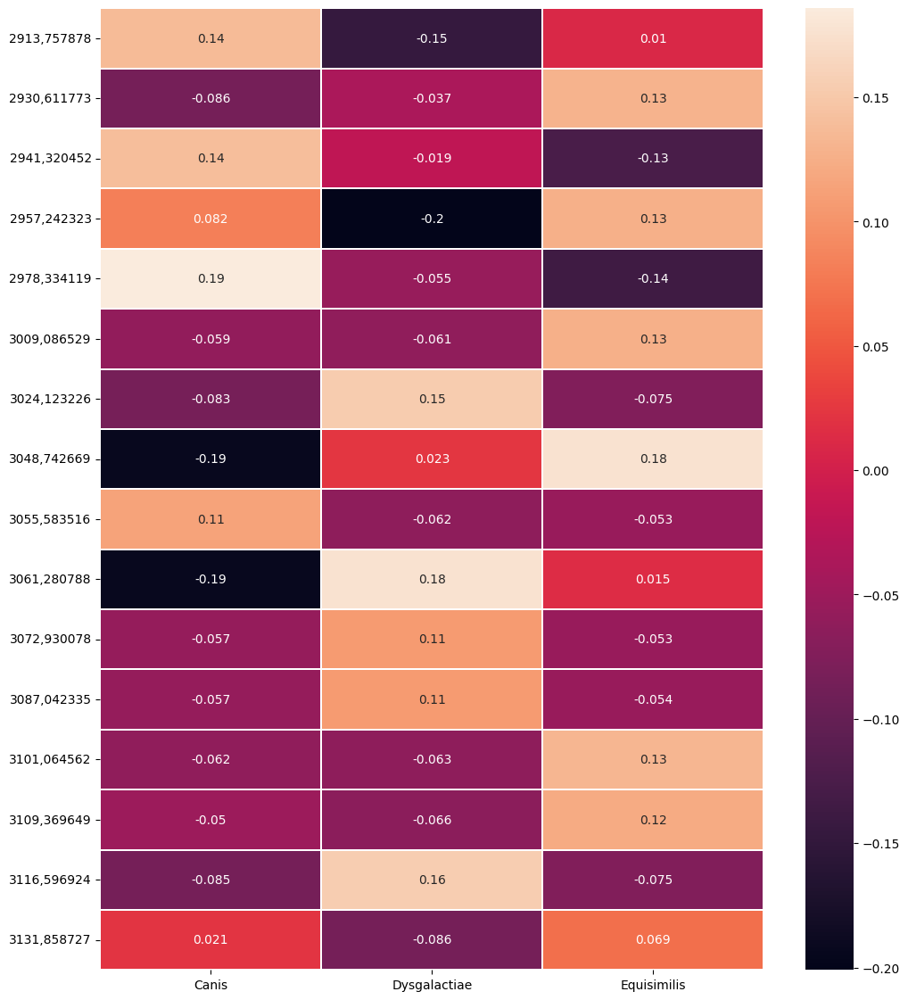

...

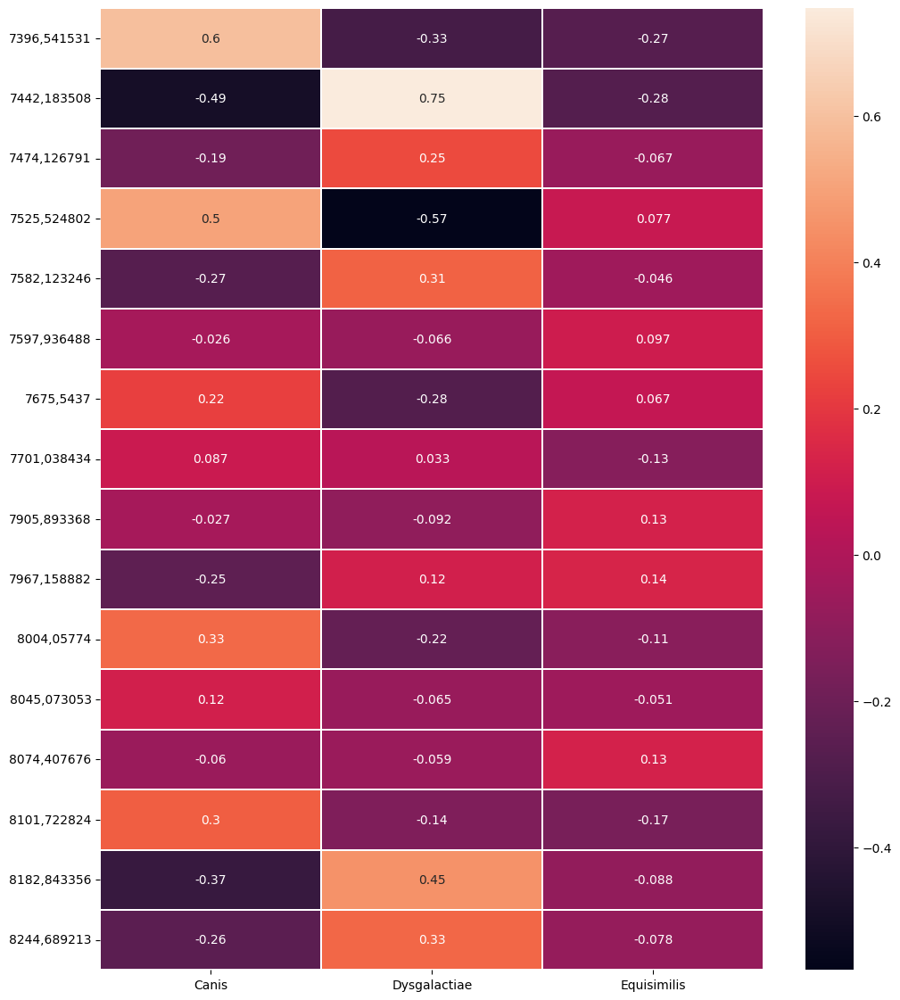

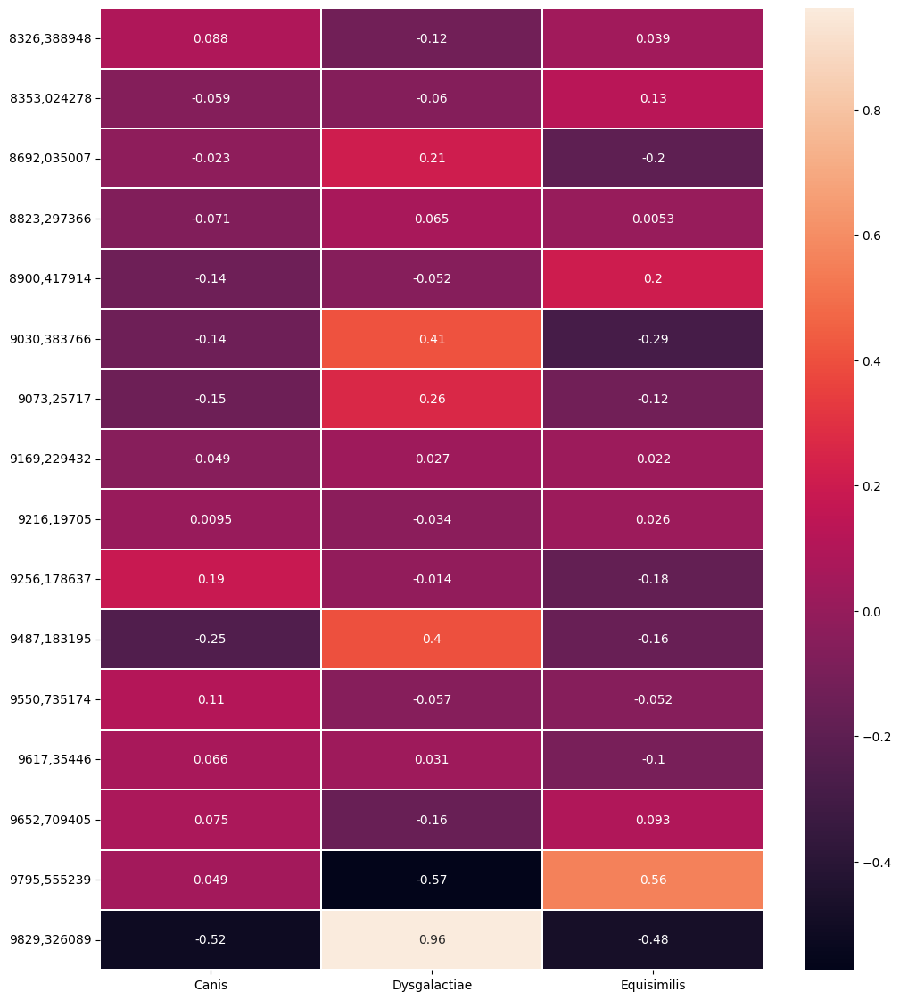

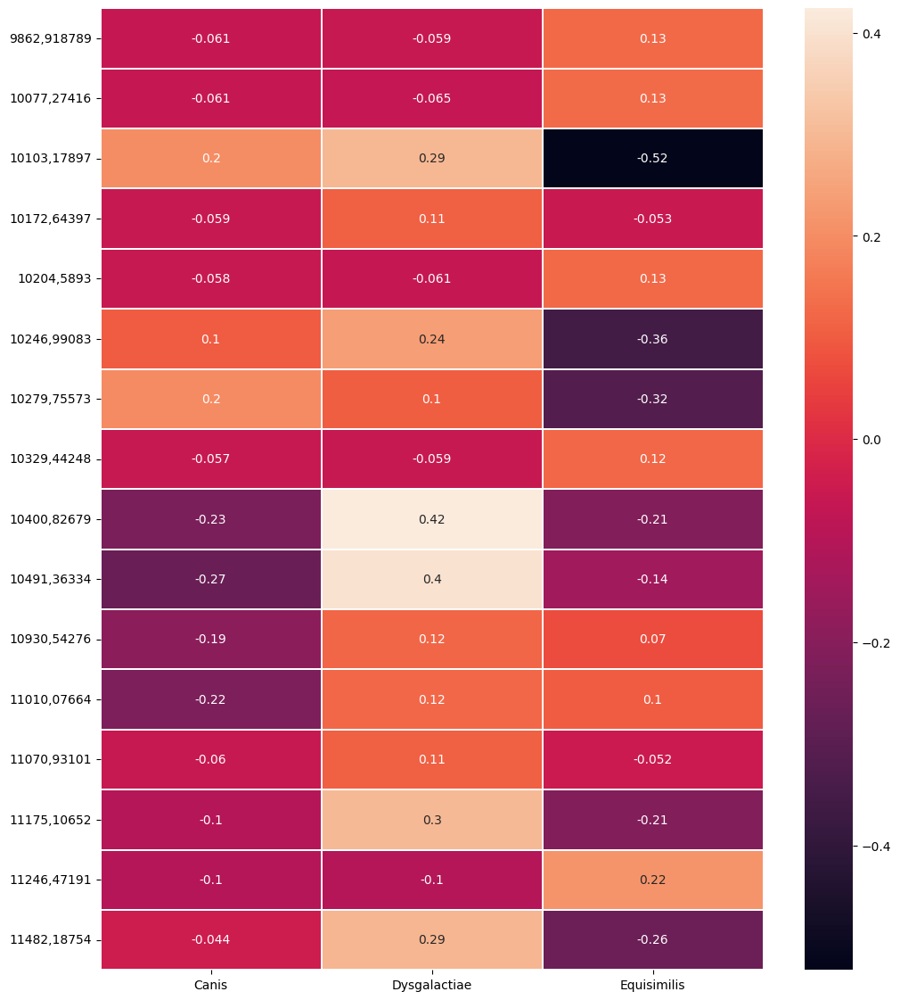

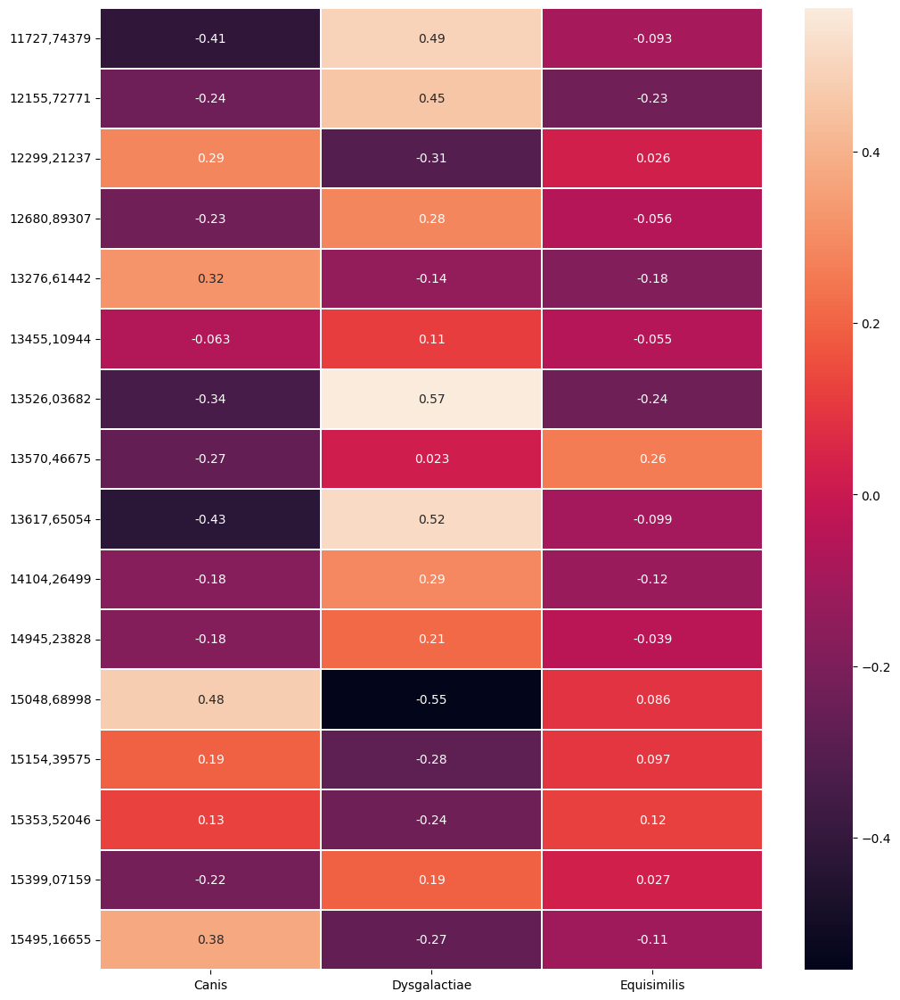

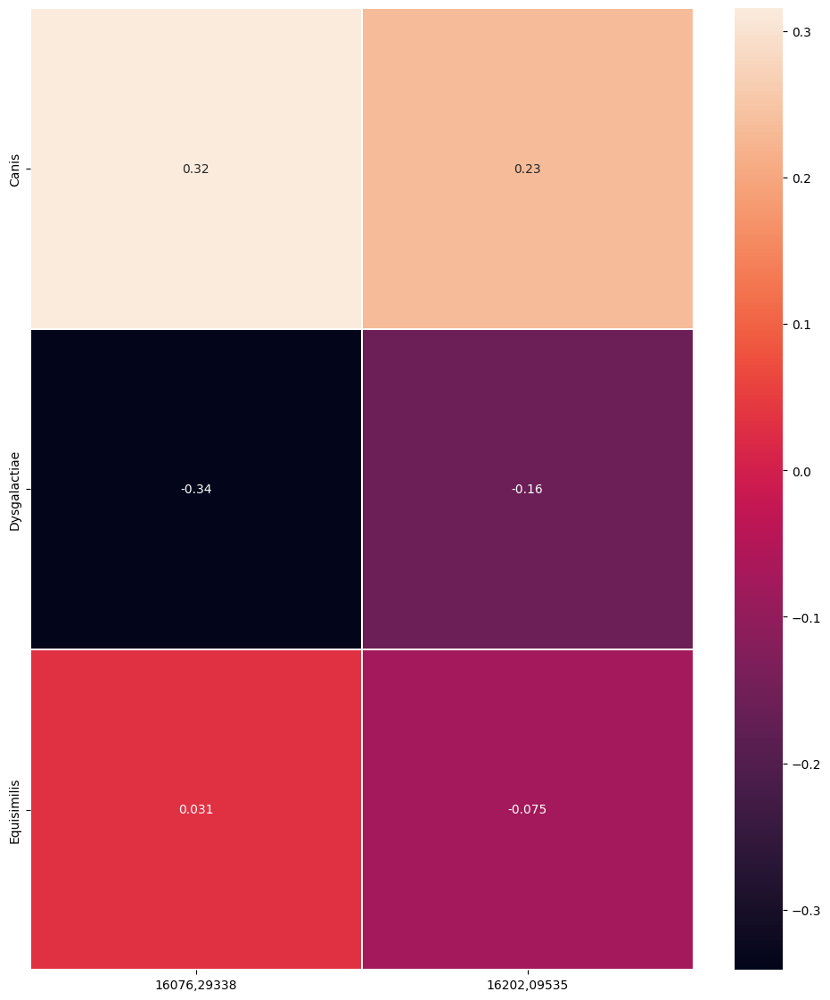

In [57]:
targets_cp = {'subspecies' : subspecies}

for column_i,column_f in dict_column.items():
    maldi_reduced = maldi.iloc[:, column_i:column_f]
    display(maldi_reduced)
    
    for str_target, target in targets_cp.items():
        if str_target == 'subspecies':
            target = pd.DataFrame.from_dict(pd.get_dummies(target))
            target = target.rename(columns = {'Putative Subspecies_Streptococcus canis': "Canis",
                'Putative Subspecies_Streptococcus dysgalactiae subsp. equisimilis' : "Equisimilis",
                'Putative Subspecies_Streptococcus dysgalactiae subsp. dysgalactiae' : "Dysgalactiae"})
            display(target)
            #print(targ_feat.corr()[feat_agg.columns])
            plt.figure(figsize=(12, 14))
        else:
            plt.figure(figsize=(10, 6))
        targ_feat = pd.concat([target, maldi_reduced], axis=1)
        #print()
        if target.shape[1] > maldi_reduced.shape[1]:
            corr_target = targ_feat.corr().filter(items = maldi_reduced.columns, axis=1).filter(items = target.columns, axis=0)
            sns.heatmap(corr_target, annot=True, linewidths=0.2)
        else:
            corr_target = targ_feat.corr().filter(items = maldi_reduced.columns, axis=0).filter(items = target.columns, axis=1)
            sns.heatmap(corr_target, annot=True, linewidths=0.2)
        
        
        #plt.savefig('../Risultati/Correlation/Maldi/'+str_target+'_'+str(n)+'_'+str(column_i)+'_'+str(column_f)+'.png')

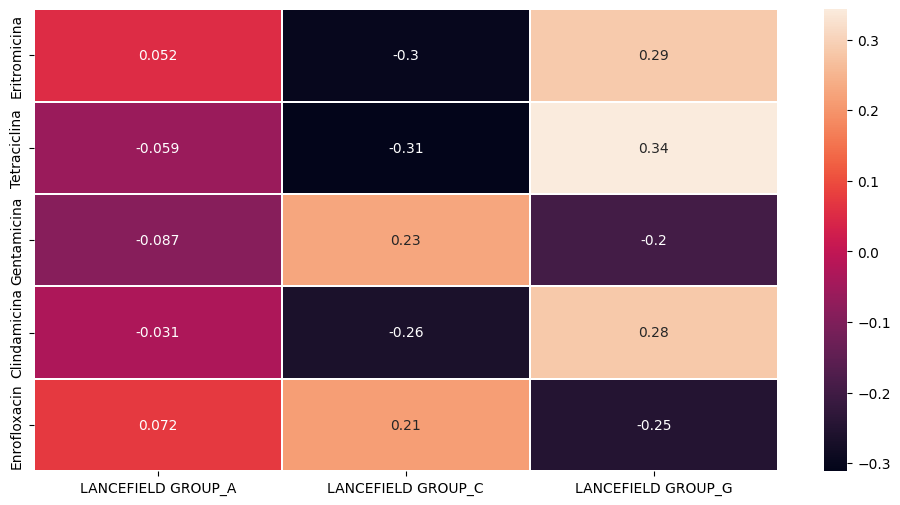

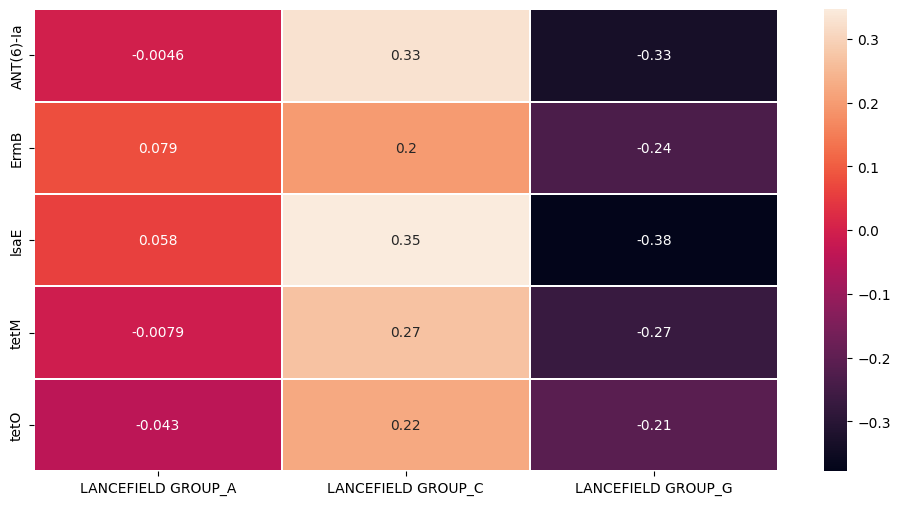

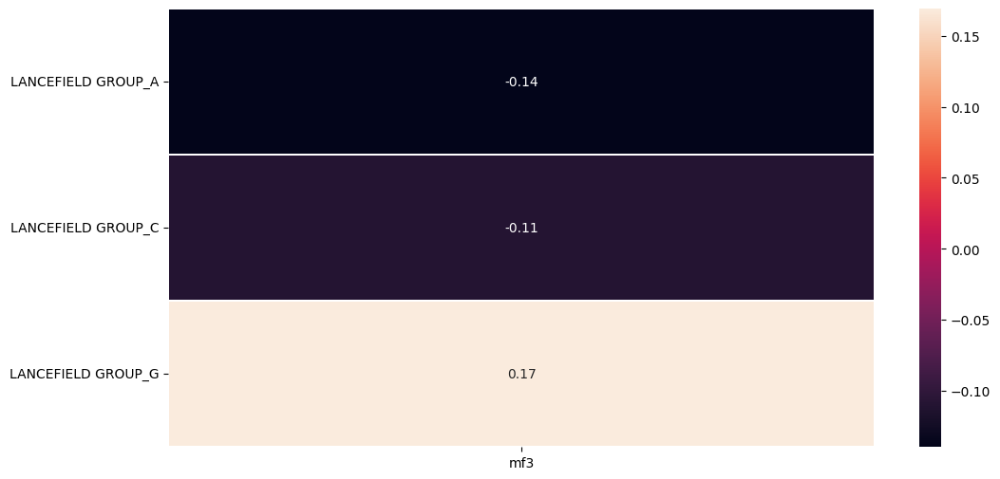

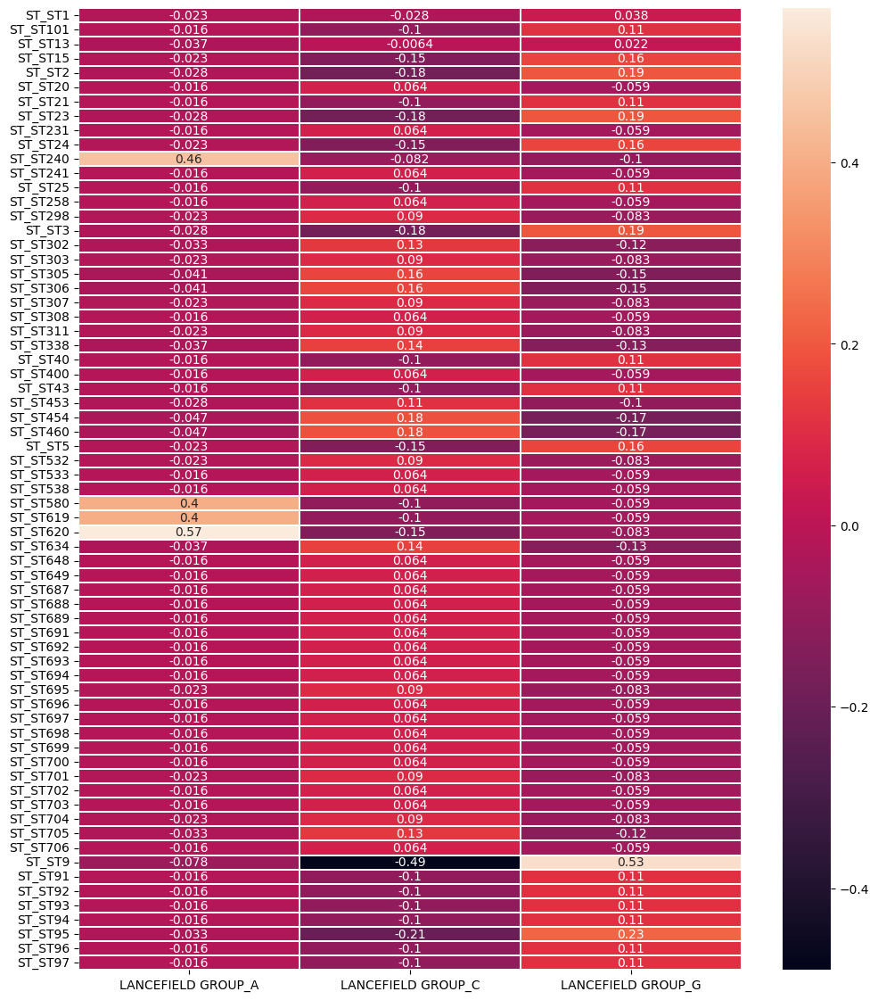

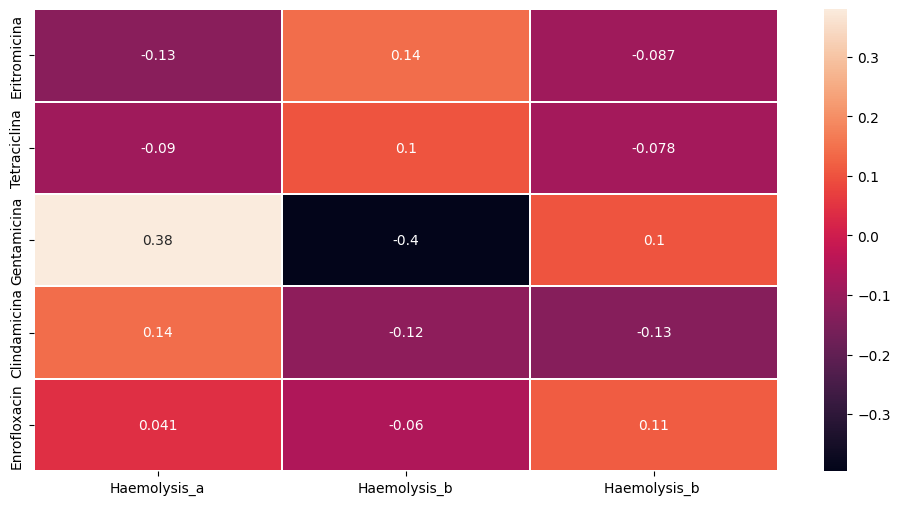

...

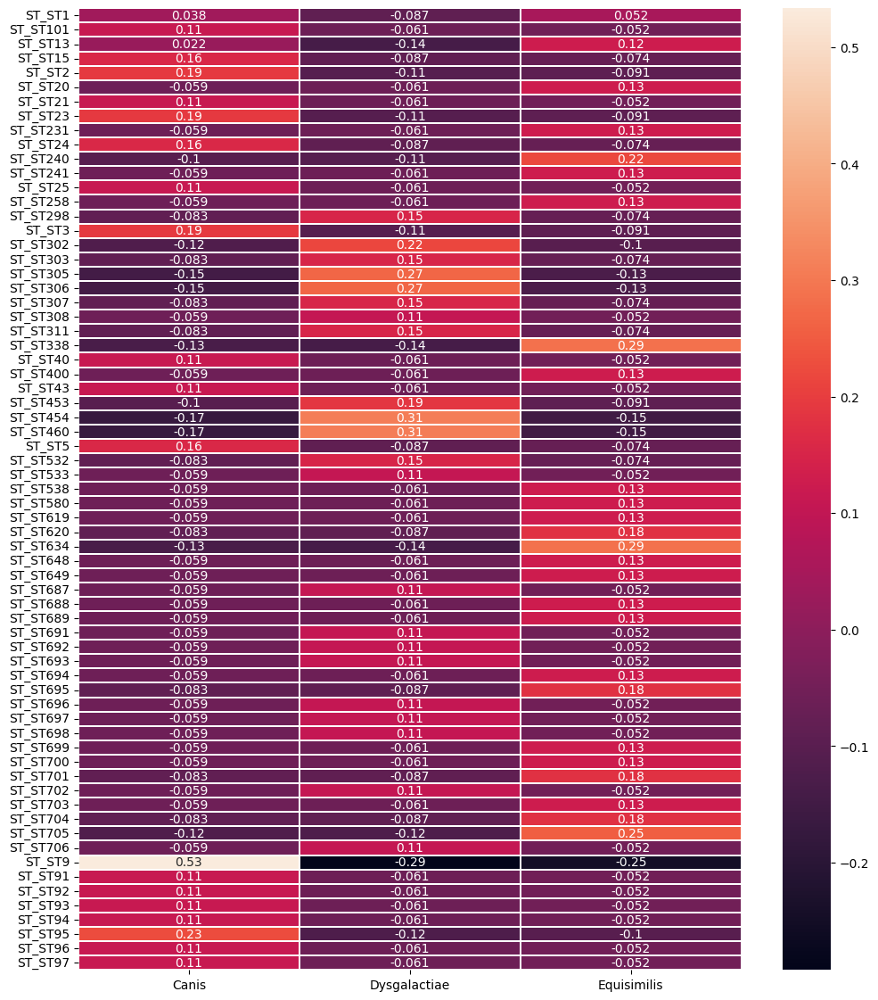

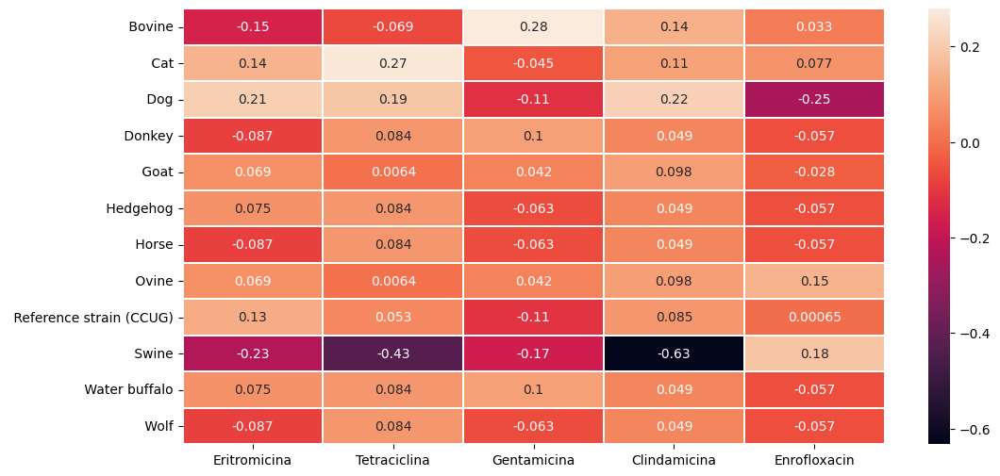

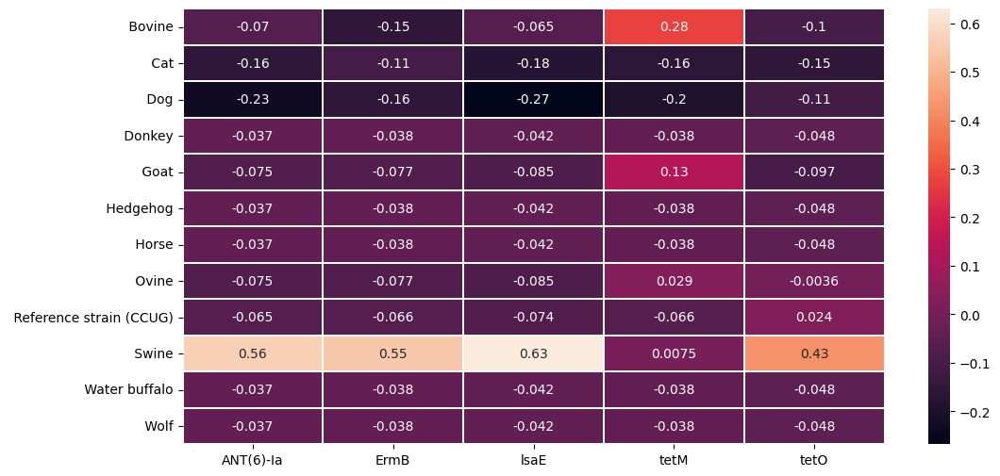

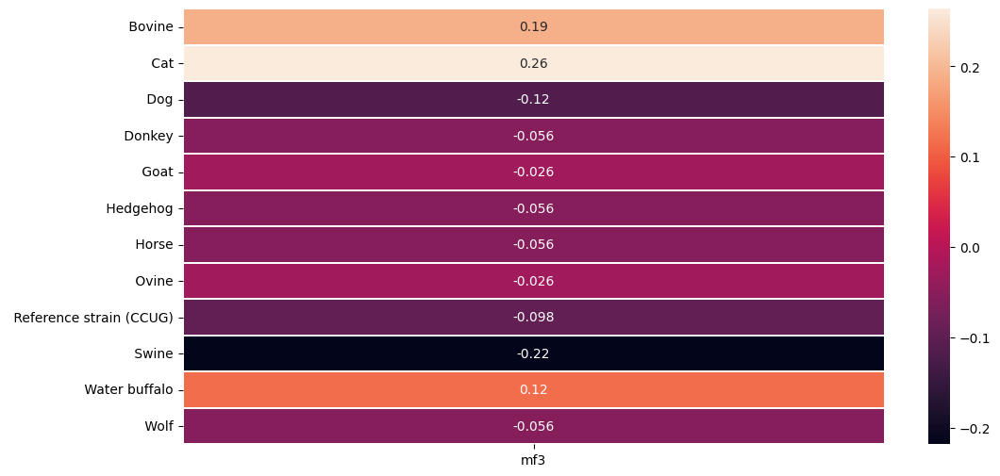

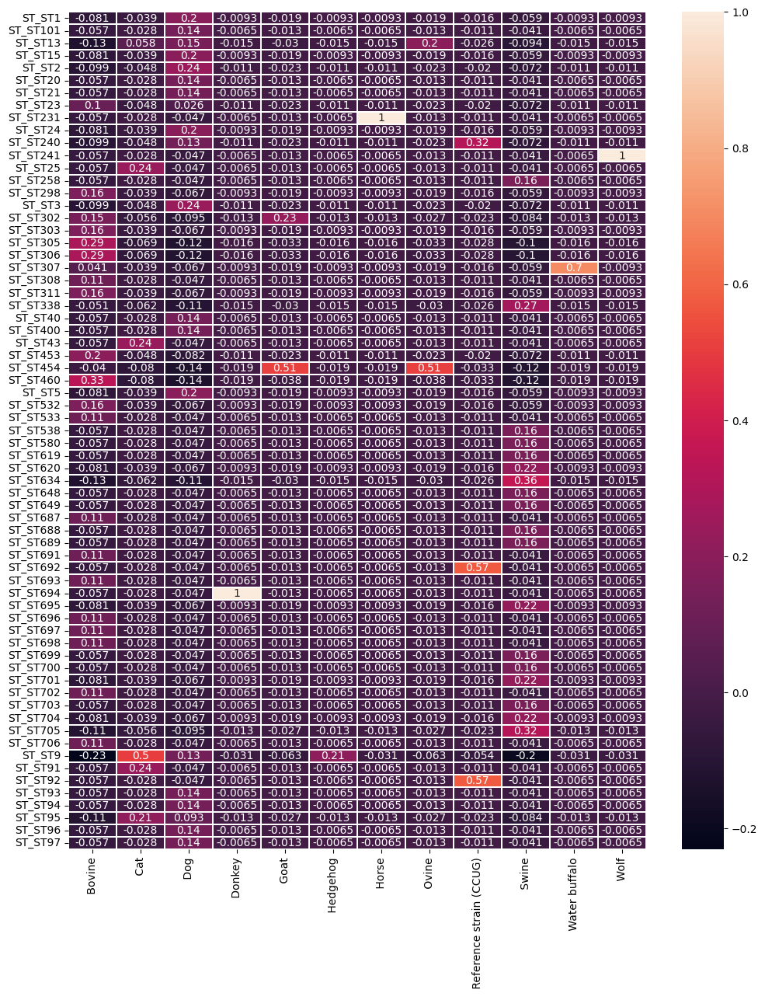

In [58]:
for str_feat, feat_agg in feats_agg.items():
    feat_agg = pd.DataFrame.from_dict(pd.get_dummies(feat_agg))
    if str_feat == 'subspecies':
        feat_agg = feat_agg.rename(columns = {'Putative Subspecies_Streptococcus canis': "Canis",
        'Putative Subspecies_Streptococcus dysgalactiae subsp. equisimilis' : "Equisimilis",
        'Putative Subspecies_Streptococcus dysgalactiae subsp. dysgalactiae' : "Dysgalactiae"})
    if str_feat == 'animal':
        feat_agg.columns = feat_agg.columns.str.replace('Animal species of origin_',' ')
    for str_target, target in targets.items():
        if str_target == 'st':
            target = pd.DataFrame.from_dict(pd.get_dummies(target))
            #print(targ_feat.corr()[feat_agg.columns])
            plt.figure(figsize=(12, 14))
        else:
            plt.figure(figsize=(12, 6))
        targ_feat = pd.concat([target, feat_agg], axis=1)
        print()
        if target.shape[1] > feat_agg.shape[1]:
            corr_target = targ_feat.corr().filter(items = feat_agg.columns.tolist(), axis=1).filter(items = target.columns.tolist(), axis=0)
            sns.heatmap(corr_target, annot=True, linewidths=0.2)
        else:
            corr_feat = targ_feat.corr().filter(items = feat_agg.columns.tolist(), axis=0).filter(items = target.columns.tolist(), axis=1)
            sns.heatmap(corr_feat, annot=True, linewidths=0.2)
        #plt.savefig('Risultati/Correlation/'+str_feat+'_'+str_target+'.png')

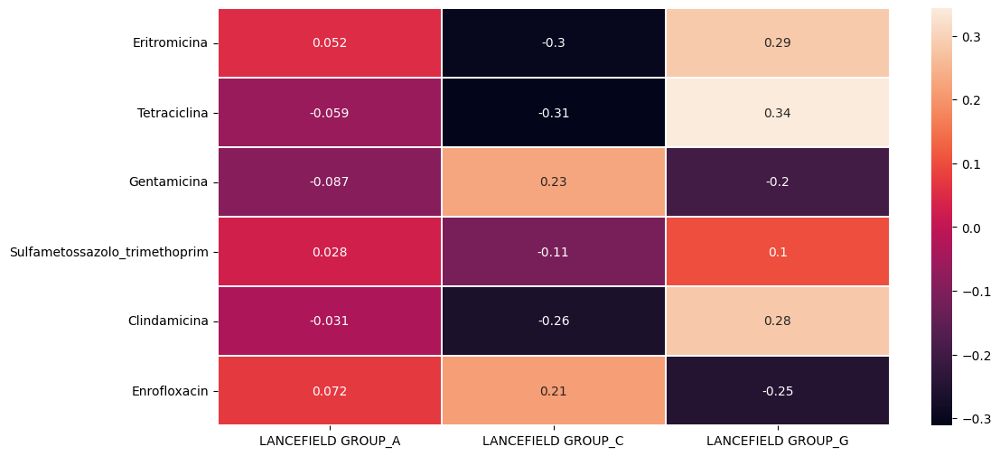

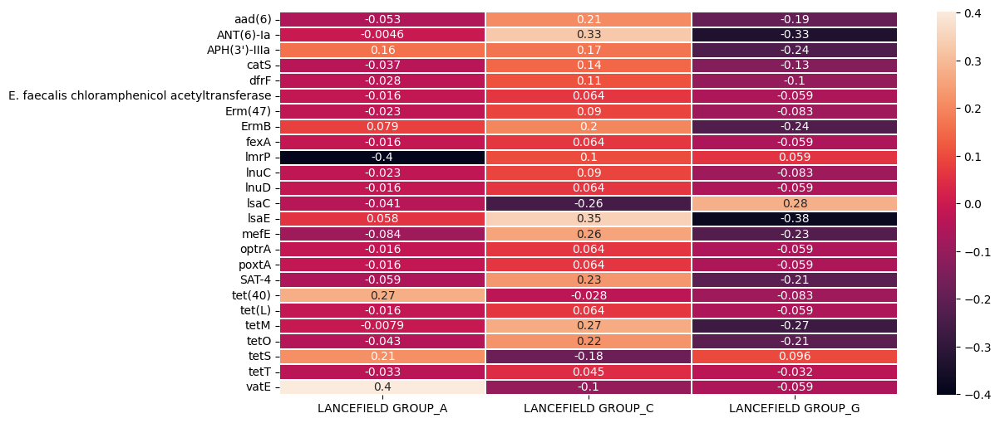

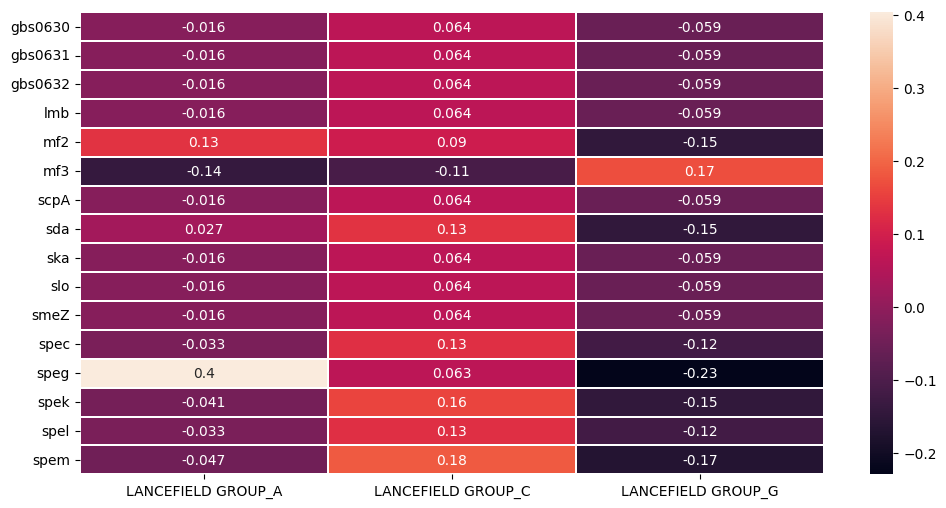

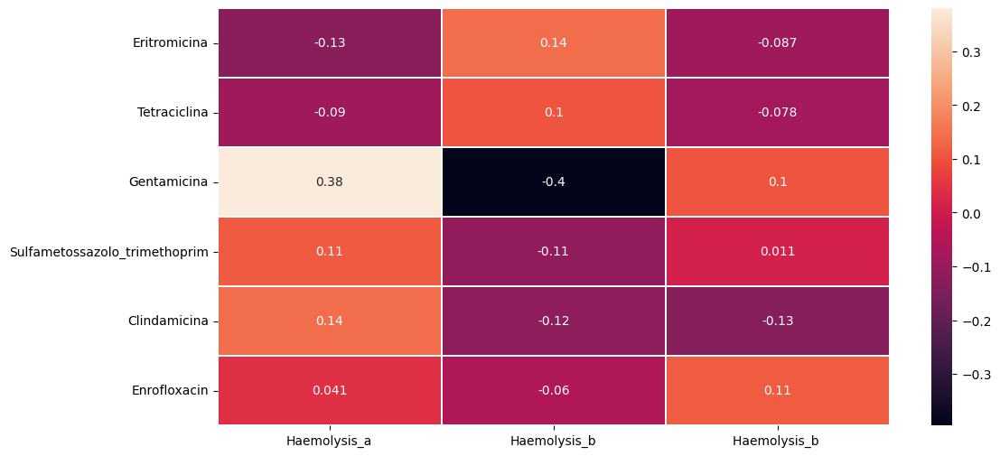

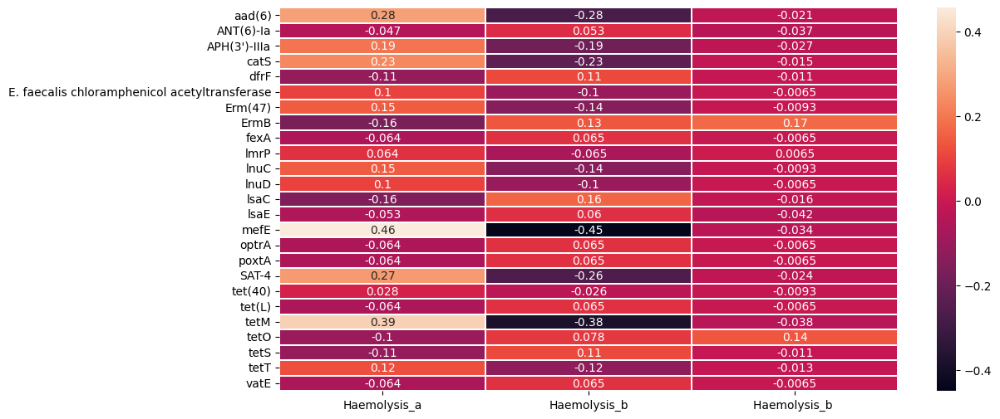

...

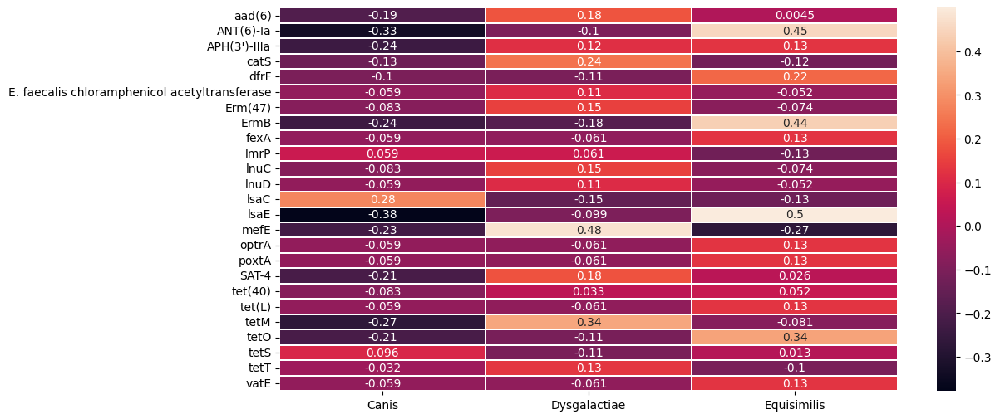

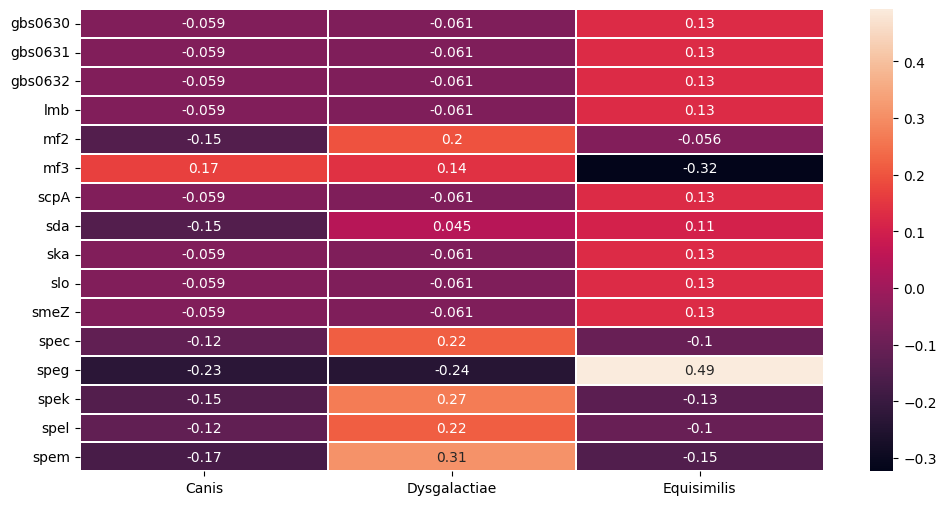

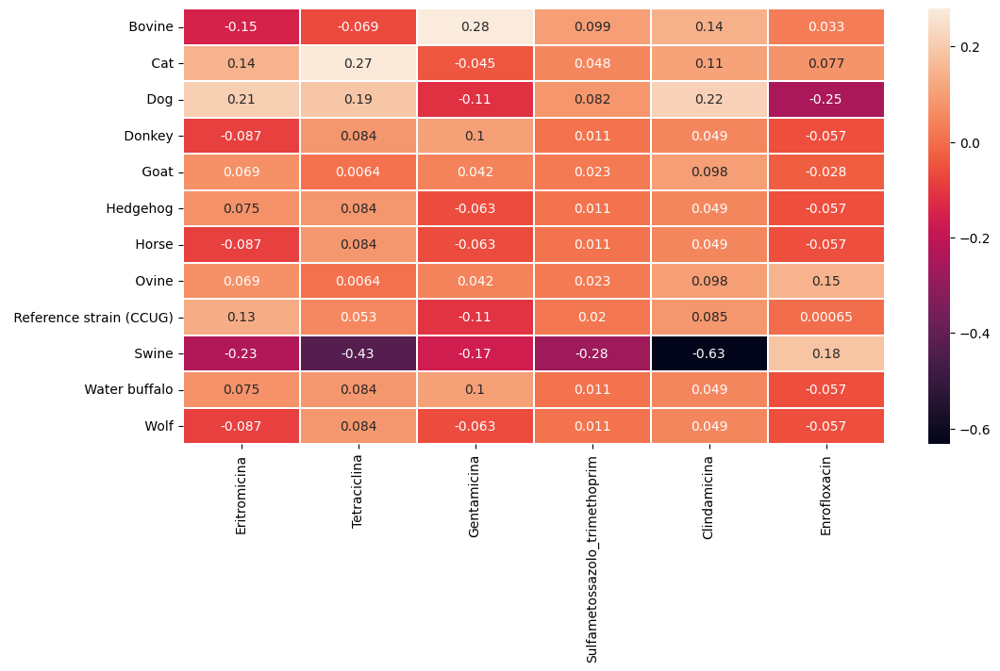

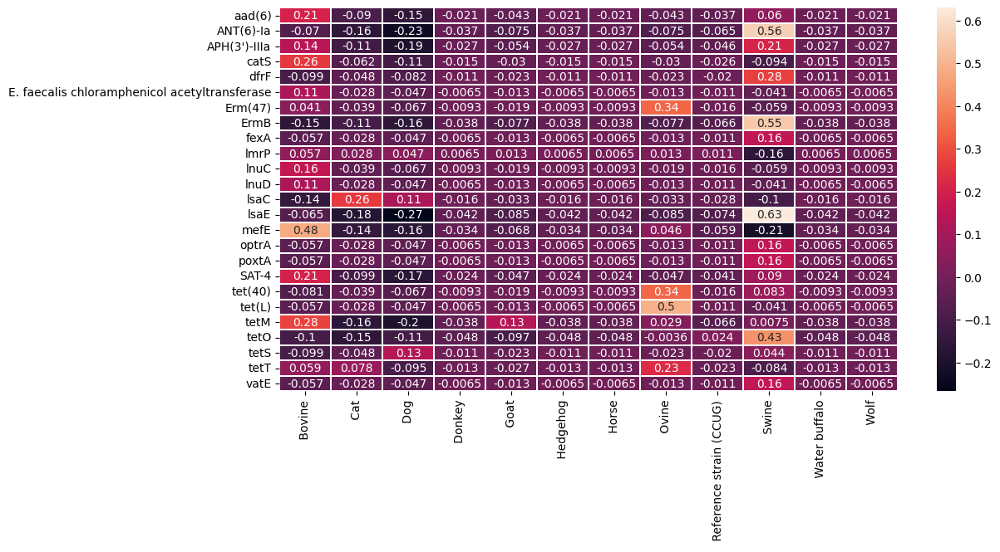

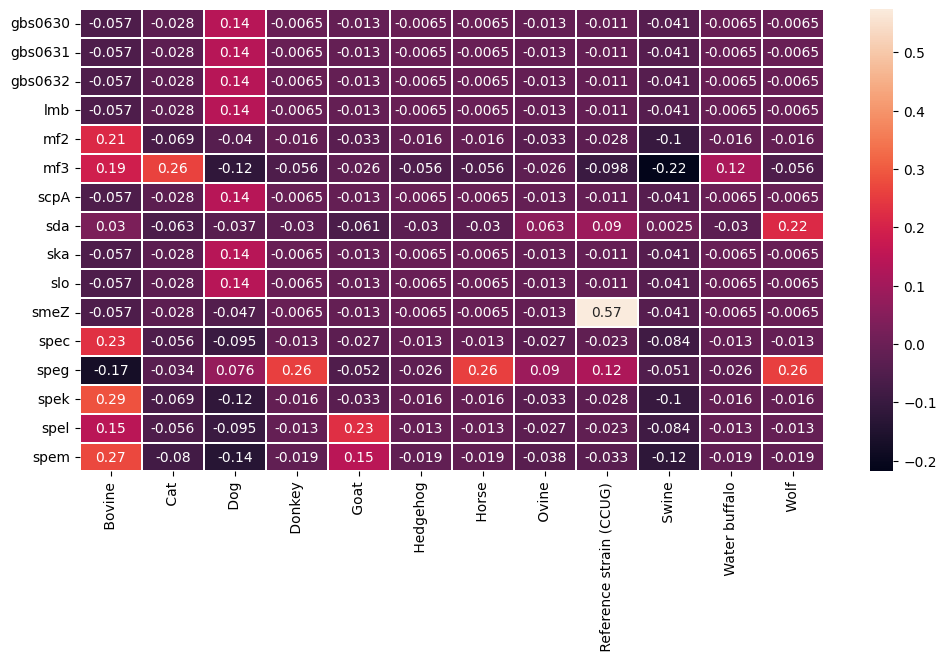

In [59]:

animal  = df[['Animal species of origin']]
lancefield = df[['LANCEFIELD GROUP']]
haemolysis = df[['Haemolysis']]
subspecies = df[['Putative Subspecies']]
st = df[[df.columns[4]]]
antibiotici = df[df.columns[start+n:start+n+n_antibiotici]]
geni_antibiotici = df[df.columns[start+n+n_antibiotici:start+n+n_antibiotici+n_geni]]
virulenza = df[df.columns[start+n+n_antibiotici+n_geni:start+n+n_antibiotici+n_geni+n_virulenza]]

targets = {'antibiotici' : antibiotici,
            'geni_antibiotici' : geni_antibiotici,
            'virulenza' : virulenza}

feats_agg = {'lancefield' : lancefield,
            'haemolysis' : haemolysis,
            'subspecies' : subspecies,
            'animal' : animal}

for str_target,target in targets.items():
    columns = target.columns
    for column in columns:
        if str_target == 'antibiotici':
            target[column] = df[column].map(map_target_antibiotici)
        rapporto = (target[column] == 0).sum() / target.shape[0]
        #print(column+" : "+str(rapporto))
        if rapporto == 0 or rapporto == 1:
            target.drop([column], axis=1, inplace=True)
            
for str_feat, feat_agg in feats_agg.items():
    feat_agg = pd.DataFrame.from_dict(pd.get_dummies(feat_agg))
    if str_feat == 'subspecies':
        feat_agg = feat_agg.rename(columns = {'Putative Subspecies_Streptococcus canis': "Canis",
        'Putative Subspecies_Streptococcus dysgalactiae subsp. equisimilis' : "Equisimilis",
        'Putative Subspecies_Streptococcus dysgalactiae subsp. dysgalactiae' : "Dysgalactiae"})
    if str_feat == 'animal':
        feat_agg.columns = feat_agg.columns.str.replace('Animal species of origin_',' ')
    for str_target, target in targets.items():
        if str_target == 'st':
            target = pd.DataFrame.from_dict(pd.get_dummies(target))
            #print(targ_feat.corr()[feat_agg.columns])
            plt.figure(figsize=(12, 14))
        else:
            plt.figure(figsize=(12, 6))
        targ_feat = pd.concat([target, feat_agg], axis=1)
        #print()
        if target.shape[1] > feat_agg.shape[1]:
            corr_target = targ_feat.corr().filter(items = feat_agg.columns.tolist(), axis=1).filter(items = target.columns.tolist(), axis=0)
            sns.heatmap(corr_target, annot=True, linewidths=0.2)
        else:
            corr_feat = targ_feat.corr().filter(items = feat_agg.columns.tolist(), axis=0).filter(items = target.columns.tolist(), axis=1)
            sns.heatmap(corr_feat, annot=True, linewidths=0.2)
        #plt.savefig('../Risultati/Correlation/'+str_feat+'_'+str_target+'.png')

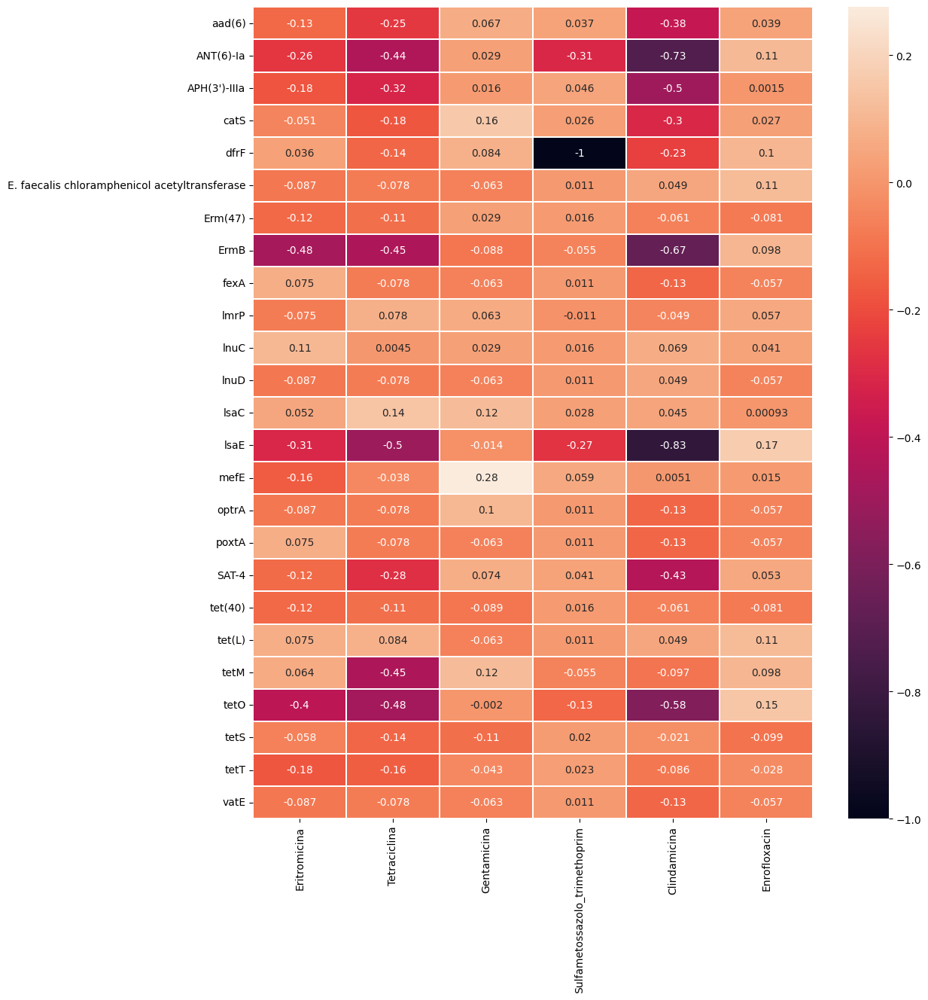

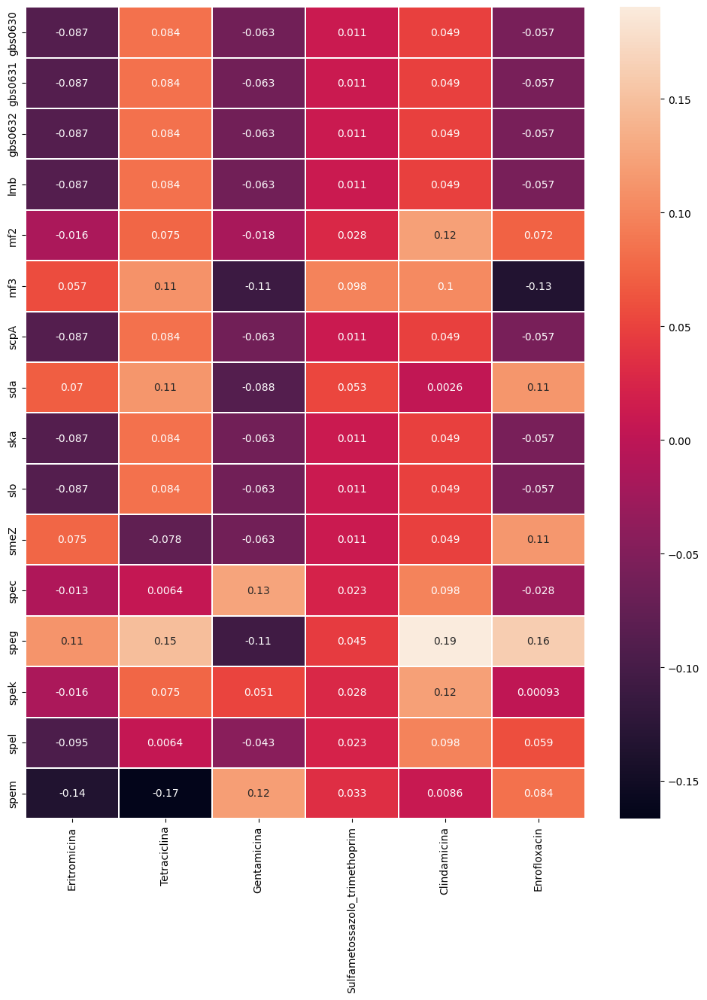

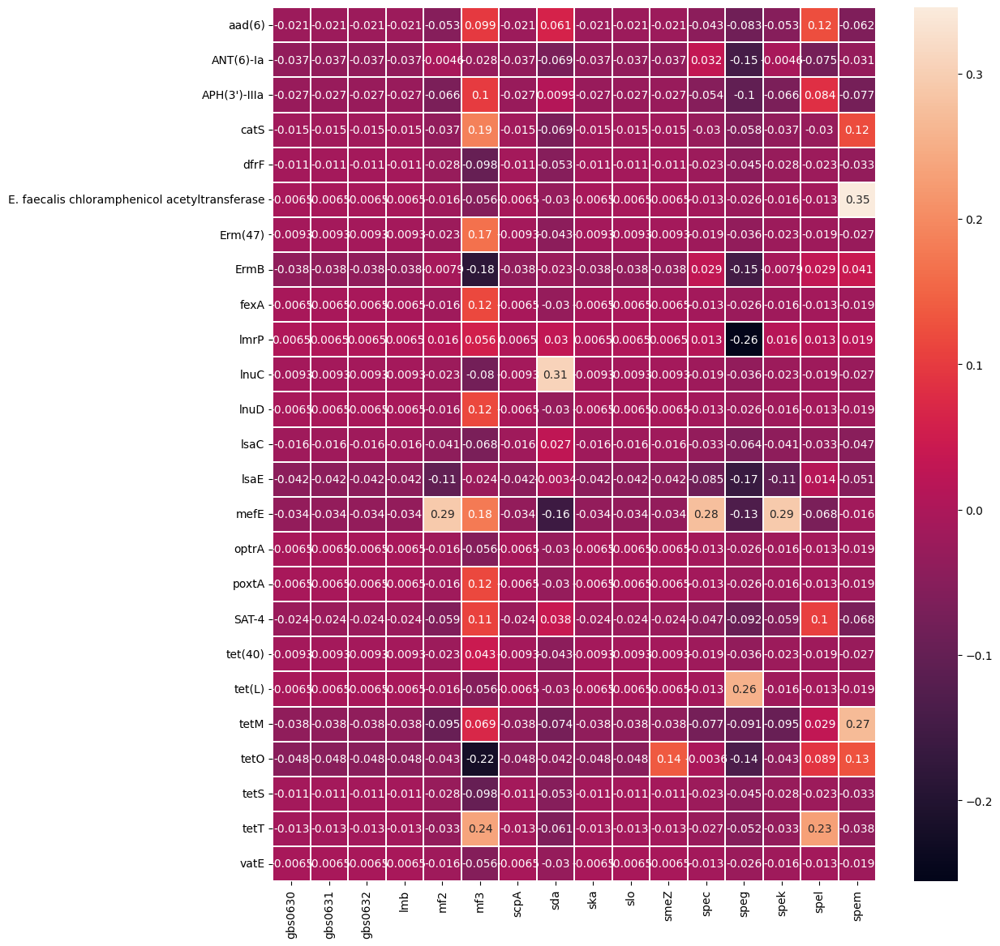

In [60]:
targets2 = targets.copy()
for str_target, target1 in targets.items():
    targets2.pop(str_target)
    for str_target2, target2 in targets2.items():
        plt.figure(figsize=(12, 14))
        targ_feat = pd.concat([target1, target2], axis=1)
        if target1.shape[1] > target2.shape[1]:
            corr_target = targ_feat.corr().filter(items = target2.columns.tolist(), axis=1).filter(items = target1.columns.tolist(), axis=0)
            sns.heatmap(corr_target, annot=True, linewidths=0.2)
        else:
            corr_feat = targ_feat.corr().filter(items = target2.columns.tolist(), axis=0).filter(items = target1.columns.tolist(), axis=1)
            sns.heatmap(corr_feat, annot=True, linewidths=0.2)
        #plt.savefig('../Risultati/Correlation/'+str_target+'_'+str_target2+'.png')